<a href="https://colab.research.google.com/github/Padmapalita/Portfolio_Classic_Machine_Learning/blob/main/Reducing_algorithmic_bias_in_Audio_Classification_Full_machine_learning_discovery_process.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Reducing algorithmic bias in Audio Classification 
## Full machine learning discovery process

This project was completed as part of my Masters Data Science and Artifical intelligence. 

The assignment task was to define your own machine learning problem with a dataset the course participants had created. These were audio recordings in 36 specific locations across 6 areas of london. The recordings had a set phrase at the start of each recording, then ambient noise of the location. recording were to be atleast 7 seconds long. 

### The problem I have chosen to work on is in two parts. 
**Part 1: Recognising Male and Female voices contained within the audio.**

**Part 2: Reducing, as much as possible, the difference in accuracy between male and female voices.**

This was a reasonable problem as the dataset had 69 females compared to 106 male voices. So the imbalance in the dataset could be expected to favor male voices if not managed in the model selection process. 


#### The following notebook is an example of the type of exploration I might do in developing a light weight ML model for production. 

However DeepLearning tools were excluded from the exploration. This assignment was to be a 'classical' feature eningeering and ML model training exercise. 

# 2 Problem formulation

Describe the machine learning problem that you want to solve and explain what's interesting about it.

Problem: Build an ML pipeline which can predict the sex of the speaker, based on labels that I have created. 
I am particularly interested in algorithmic bias and wanted to explore this. Rather than use the term gender, which is less easy to identify via voice, I have listened to each participant and created two list of males and females which contain participant IDs. 

I'm aware that there is a gender imbalance in the class and wanted to see the effect of this in how an ML pipeline is trained, and how models can be judged as successfull when trying to equalise the predictive power for both classes even if there is an imblanace in the dataset. 

I will judge the best model as being the one which minimises the difference in Postive Predictive Value (That a predicted male voice is a male) and Negative Predictive Value (that a predicted female voice is a female), and maximising over all Accuracy. 

To do this I will use a confusion matrix to calculate these values along with senstivity, specificity. 

# 3 Machine Learning pipeline

In this section I will describe the ML pipeline to be used in production. 
for a description of how this pipeline was created, the experiments were run and their results, please see the sections below. 


## Data inputs
- a .wav audio file
- length must be greater than 2 seconds, ideally no more than 15 seconds


## Data preprocessing

#### Selection of best subsample from audio sample
input: Pathway to files
- Calculate four 1.5 second duration offsets from each audio sample. 
- Identify the percentage voiced for each subsample using librosa.pyin()
- Select the subsample with the highest percentaged voice for full processing
output: a 1.5 second offset for each file to used for feature extraction

#### Process each subsample
inputs: 1.5 second subsample offset for each file.
- Extracts 3 features from the subsample
    - **pitch_mean:** The average pitch of the subsample calculated from librosa.pyin() taking np.nanmean(f0)
    - **pitch_std:** The stardard deviation of the pitch in the subsample calculated from librosa.pyin() taking    np.nanstd(f0)
    - **pow_spec_std:** The standard deviation of the chromagram of the power spectrogram using librosa.feature.chroma_stft() and taking the np.std() of the result. 
- Save canditate features to a numpy array

output: a 1X3 numpy array containing one observation, three features


## ML pipeline
input: a 1X3 numpy array containing one observation, three features
#### Data normalisation
- data is normalised within the pipeline using a standard scaler trained on the 2110 samples used in this model

#### Random Forrest Classification (class_weights='balanced' ,n_esimatiors=10)
- the nomalised data is passed into a pre-trained model

output: prediction, If True = male predicted, if False = female predicted

**This ML pipeline has an estimated accuracy of 86%**

**with a predictive value of 88.1% that a male prediction is from a male voice.**

**and a preductive value of 82.3% that a female prediuction is from a female voice**


# 4 Transformation stage

In this section I will out line the early stages of the ML process, from the raw inputs, and experimental process used to arrive at the final transformed data used by the ML model. 

## Data inputs
- 2500 .wav audio samples from across london
- MLendLS.csv containing label information indexed by audio sample names


## Data preprocessing
### The numbered sections relate to the experiments in the later sections


### 7.01 Select best subsample from each audio sample
input: Pathway to files
- Calculate four 1.5 second duration offsets from each audio sample. 
- Identify the percentage voiced for each subsample
- Select the subsample with the highest percentaged voice for full processing
- This stage removes un-needed noise from the signal which we are interested in (the voice)
output: a 1.5 second offset for each file to used for feature extraction

### 7.02 Process each subsample

inputs: 1.5second subsample offset for each file.
- Extract 40 canditate features from the subsample
**candidate features created are:** 

power: The average power output from the subsample

pitch_mean: The average pitch of the subsample

pitch_std: The standard deviation of the pitch calculated from the subsample

mfcc_01, mfcc_02 , mfcc_03 , mfcc_04 , mfcc_05 , mfcc_06 , mfcc_07 , mfcc_08 , mfcc_09 , mfcc_10 , mfcc_11 , mfcc_12 , mfcc_13: These are the first 13 Mel Frequency Cepstral Coefficents (MFCCs) which are widely used in speech recognition applications. 

rms_01 , rms_02 ,  rms_03 , rms_04 , rms_05 , rms_06 , rms_07 , rms_08 , rms_09 , rms_10: the averaege of the first 10 values from root-mean-square (RMS) value for each frame. This is a simplified version of STFT Short-time Fourier transform. I was interested to see if this could provide a signal, so included it. 

ft_mean: Is the avereage of the STFT Short-time Fourier transform after being transformed to decibels. It is a measure of frequency over time, and a precursor to the power_spectralgram (see below)

ft_std: the standard deviation of the FT mean sample calculated from the subsample. 

contrast_mean: Contrast is a measure of the highs and lows within a sample frame. I have taken the avereage of the subsample. 

contrast_std: The standard deviation of the contrast_spectrum calculated from the subsample

p1_mean: mapping the subsample against a order of polynopmial (n=1) returns a simplified visual description of the sample. I have taken the mean of the P1 values from each sub sample. 

p1_std: the standard deviation of the P1 polynomial calculated from the subsample. 

zero_crossing_mean: the zero corssing rate is the time taken for an audi sample to cross the zero point to postive or negative values, it can be thought of as a measure of variability in the sample. I have taken the mean value calcualted from the subsample. 

zero_crossing_std: the standard deviation of the zero crossing values caculated from the sub sample. 

pow_spec_mean: the power spectrogram is calculated from the STFT is a more complex (fuller) description of frequency over time. The mean of the subsample is taken in this measure 

norm_pow_spec_mean: The normalised vector of the power spectogram (as above). The mean of the subsample is taken.

pow_spec_std: The standard deviation of the power spectrogram of the sub sample

norm_pow_spec_std: the standard deviation of the normalised power spectrogram. 

spec_roll_mean: The spectral roll off is a feature which can be used to estimate the maximum frequency of the sub sample. The mean of the subsample is given. 

spec_roll_std: the standard deviation of the spectral roll off. 

- Save canditate features to a dataframe along with labels from MLendLS.csv

output: Data fram containg the candiatate features and original labels. 

output: a CSV of the above dataframe for backup. 

### 7.03 Removal of observations with NaN values
- 390 samples failed to return pitch_mean or pitch_std after processing, any observation with NaN as a value in these two canditates are removed from the feature dataframe. 
- This step was taken as earlier experiments showed the importance of these two canditates and how removing NaNs rather than replacing them with 0.0 led to a better priction space for our model evaluation stage. 

### 7.04 Manual process for labeling sex of speaker using participantID
- a use a function to give one audio sample for each pariticipant in the data set
- a use helper function to give all audio samples for a named pariticpant (if a voice is dificult to classify). 
- Manual task: create two lists of participantIDs catergorised as Males and Females

output: Two lists of participantIDs males and females

### 7.05 Create male label from participant label and Males/Females lists
- We now apply a function to create an additional column in the dataframe. 
- This will label each observation as male (voice) True or False based on the participant ID
- Any observation with a participantID not in the males or females list will be printed out. 

outputs: Dataframe with column 'male' containing True and False values


### 7.06 create a list of labels for data visualisation
- Create a list of labels called 'sexes' from the male column encoding 1 for True/male, -1 for False/female. 

outputs: A list 'sexes' for use in the data exploration stage containing values 1(male) and -1(females) 


## Data exploration
### the numbered sections relate to the experiments in the later sections
inputs: Dataframe with column 'male' containing True and False values

inputs: A list 'sexes' for use in the data exploration stage containing values 1(male) and -1(females) 

### 7.07 visualise the distribution of the candidate features grouped by sex
- use Histograms and density plots with normalised and un normalised data. 
- identify candidates which show variation in distribution when grouped by male label. 

### 7.08 Normalise the dataset for the remaining visualisations
- Check that the normalisation has left the histogram and density plots unchanged 

### 7.09 Pairplot each candidate feature along with sexes labels
- Pairplot all of the candidate features against each other, looking for separation between the sexes labels.

### 7.10 Explore interesting candidate pair plots in more detail
- Review sub groups of the candidates in scatterplots or pairplots to confirm groupings which show good separation between the sexes. 

### 7.11 Visualise a short-list of the candidates to decide the final set of features
- Reduce the number of features/ create a shortlist of features which are likely to create a prediction space which would maximise separation between the sexes labels. 

### 7.12 Decide on final feature set
- justify the final feature set based on data. 

### 7.13 Explore if more transformation would be of benefit

- Use a principal components analysis with 1 component to help eliminate candidate features.
- If more than 3 features have been selected, use PCA analysis to reduce the dimensionality of the data to visualise the prediction space. 

### 7.14 define the final data processing pipeline to be used for model selection
- Create a dataset ready for model selection experiments

outputs: a dataframe containing the un-normalised features and the labels for male=True


## The final set of transformations needed in production will be:
1. take a 1.5 second subsample of any audio sample provided. This must have a high percentage voice component usiung the pyin function from the librosa library. 
2. extract three features using the librosa library (and the function in 7.02)
- pitch_mean
- pitch_std
- pow_spec_std
3. this data is now ready to be passed into the production pipieline, where it will be normalised and run through the model

# 5 Modelling

After looking at the prediction space it was clear that while we have good seperation in our outcome labels we do not have clear clumps of data that a logistic regression would be able to draw a straight line through. 

because of this I have chosen models which broadcast the data into higher demensions (linearSVC, C support vector classification), create non-linear boundaries (kNeighboursClassifer, randomForrestClassifier) use the probability of the data in the model creation (guassian Naieve bayes) or can learn curved decision boundaries (Quadratic descriminant analysis), I have also included logistic regression to see what the performance of this model will be. 

If key interest to me here, is can the models predict both classes equally well. This will be a challenge for two reasons. 
- the prediction space (see figure below) shows that males are more tighly packed, and that females have a wider spread, with a number of female voices being at the lowest end of pitch_mean
- there are more male samples in the dataset, so the imbalance along with their location might lead some models to predict males well, at the cost of predicting females well. 

![fig.png](attachment:fig.png)

## Description of models used in model selection

### 8.08 LinearSVC
- Broadcasts the data into higher demensions and looks for a linear seperation. This implementation is quite computationally intensive as it needs around 4-5 thousand itterations with our current dataset. 
- I was interested to see what it would make of the prediction space

### 8.09 KNeighborsClassifier (with hyperparameter selection)
- Uses the distribution of the data to classify new observations based on k number of nearest neighbours. 
- I thought this may help with the female classification, but wanted to see which hyperparameter would retrun the best predictive values. 

### 8.10 RandomForestClassifier (with hyperparameter selection)
- Defines the classifier by how the prediction sapce can be split to reach a state where each leaf is pure or 100% of one class
- I thought this might be ideal for the prediction space seen in data exploration. 

### 8.11 C-Support Vector Classification
- Broadcasts the data into higher deminsions and looks for a linear seperation. C is a hyper parameter which is translated as the inverse of the regularisation the model applies to the data.
- This model also has another hyperparmeter 'gamma' which is a co-efficient for the kernel used in the model
- We have stuck with te default kernel 'rbf' in this work

### 8.12 LogisticRegression 
- Standard logistic regression which uses the logit to tranform values of a linear model to probabilities

### 8.13 Gaussian Naive Bayes
- Naively assumes a guasian probability to the classes (also assumes idependance of the classes)
- I was unsure of this model, but as I am interested in the use of bayes rule in healthcare, i wanted to see how the model performed. 

### 8.14 QuadraticDiscriminantAnalysis
- Is able to draw quadratic decision boundaries rather than linear ones. 
- I wanted to see what this model did with the prediction space we are working with. 

# 6 Methodology

As my goal is predict male and females voices accurately, I will be interested in the over all accuracy, but not at the expense of one class's prediction being signficiantly worse than the others.

I'm defining this has an absolute difference of 10% between Postive predictive value (for males) and negative predictive power (for females). 

To jugde this, I have created two helper functions:
- cross_val_predict(): which implement 5 fold cross validation which will comput accuracy, but also track the actual labels vs the models predictions. 
- matrix_and_results(): Which takes the actual and predicted labels and creates a confusion matrix and calculates the sensitivity, specificity, positive predicitive value and negative predictive value. 

PPV and PNV are the key metrics for my decision, I am looking for models which can product under a 10% difference between the predictive value for males and females. Ofcourse a model with a 50% predictive power for both sexes would not be a success, so the overall accuracy needs to be as high as possible. 

The full methodology from raw features to production ready model is outlined below

### the numbered heading related to the experiments and output which can be found in the later sections

### 8.01 Split the un-normalized dataset into train and test sets
- Use a 70/30 split holding back 30% of the samples for final evaluation. 
- Take 70% of the data for model evaluation. 

### 8.02 Use a standard scaler to normalise the data
- This will re-create the predictor space we have visualised, but with new mean and standard deviation based only the X_train dataset

### 8.03 create helper functions for the model testing
- cross_val_predict() uses sklearn KFold() to complete k fold cross validation, but also records the predicted labels from each fold when it is being used as validators. This allows us to get a confusion matrix off the entire X_train dataset.  
- matrix_and_results() takes the actual labels and predicted labels from cross_val_predict(), turning them into a confusion matrix, sensitivity, specificity, positive predictive value and negative predictive value. 


### 8.04 Use k-fold cross validation to evaluate different models
- I have decided on a 5 fold cross validation strategy
- I have implemented a function which manages this process, but also keeps track of the true vs predicted labels whilst running 5 fold cross validation; these will be used in the next step of the training.
- print out the average accuracy and standard deviation of the model based on 5 fold validation. 

### 8.05 Calculate the confusion matrix for each model evaluation
- Take the true vs predicted labels for each model, calculate the confusion matric, along with sensitivity, specificity, positive predictive value and negative predictive value. 

### 8.06 Explore different hyper parameters of K-nearest_neighbour, Random Forrest Classifier, & Support Vector Machine models
- using the two sections above set up iterations of models which have hyper parameters.
- for K-nearest-Neighbour use odd numbers from 1 - 17.
- for C-Support Vector Classification loop through different C values and gamma values of the default 'rbf' and 'poly' kernels
- for Random Forest classifier change the number of estimators using 1, 3, 5, 10, 15, 20, 25, 50 and the default 100

### 8.07 Review PPV and NPV of models looking for the best all-round performing models
- After running training these models and using 5 fold cross validation to calculate the confusion matrix, 
- evaluate the best model from each family, and select the best 2 performing models. 
- Best performing will have a good agreement between Positive predictive value (for male voices), and negative predictive value (for female voices) and a high level of overall accuracy
- The goal is to achieve as little bias towards males as possible, given that more of the data is male voices. 

### 8.16 creation of pipelines for the best two performing models
- build two pipelines which use the selected transformations and best two performaing models 

### 8.17 Evaluation of best two performing models with the test dataset
- using the original un-normalised test dataset, use the predict function to obtain accuracy
- using the test dataset predictions, create a confusion matrix and calculate postive and negative predictive values


### 8.18 Selection of the best performing model
- select the best model based on reducing the difference between predictive value of male and females voices.
- Our goal is to maximising accuracy for both classesm which means minimising bias in predictive value for male vs female voices. 

### 8.19 Final training of the final model with the entire dataset ready for production. 
- retain the final model with all the avaliable data, ready for production or client validation. 
- we can estimate accuracy and predictive value using our test set (8.18), but want to give the model as much information as possible for its work in production.



# 7 Dataset

In this section we will walk through the process of extracting canditate data freatures from the audio samples, label creation of the sexes of each pariticipant. 

We then explore the dataset using visualisations and reduce our canditat list down to a final feature set. 

My approach, not being deeply familiar with audio signal processing, I will rely of the experience of others in the field and heavy leverage features which can be extracted using the librosa library. (https://librosa.org/doc/latest/index.html)

I will then let the data decide which candidate features are the most suitable to move into our final set. 

Each step in this process of extraction and exploration has been given a sub section number, which should allow the reader to understand the steps and decisions taken to arrive at your final dataset. 

### 7.01 Select best subsample from each audio sample
- Calculate four 1.5 second duration offsets from each audio sample. 
- Identify the percentage voiced for each subsample
- Select the subsample with the highest percentage voice for full processing


In [ ]:
## import libraries needed for dataset creation and canditate feature exploration
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.lines as mlines
import os, sys, re, pickle, glob
import IPython.display as ipd
from tqdm import tqdm
import librosa

In [ ]:

# import the files
sample_path = '/Users/todddonnelly/uni_Machine_learning/miniproject/samples/*.wav'
files = glob.glob(sample_path)

# load the labels into a dataframe
Labels_DF = pd.read_csv('MLEndLS.csv').set_index('file_id') 

In [ ]:
# this function creates 4 offsets with a duration of 1.5 seconds for each audio file
def get_offsets_durations(file):
    length = librosa.get_duration(filename=file)
    start_sample = 0.2
    first_half_sample = length/2 - 1.5
    second_half_sample = length/2
    end_sample = length-2.0
    offsets = [ start_sample,first_half_sample,second_half_sample, end_sample ]
    durations = [1.5, 1.5, 1.5, 1.5]
    return offsets, durations

In [ ]:
# this function selects one of the four subsamples from get_offsets_durations()
def select_subsample(file, offsets, durations):
    voiced_percent = []
    for i in range(0, len(offsets)):
        fs = 22050
        y, sr = librosa.load(file,sr=fs, offset=offsets[i], duration=durations[i])
        winLen = 0.02 
        p = winLen*fs
        frame_length = int(2**int(p-1).bit_length())
        hop_length = frame_length//2
        _, voiced_flag, _ = librosa.pyin(y=y, fmin=80, fmax=450, sr=fs,frame_length=frame_length,hop_length=hop_length)
        voiced_fr = np.mean(voiced_flag)
        voiced_percent.append(voiced_fr)
        i += 1

    sorted_sample_indexs = np.argsort(voiced_percent)
    best_index = sorted_sample_indexs[3]
    offset = offsets[best_index]
    duration = durations[best_index]
    return offset, duration

### 7.02 Process each subsample
- Extract 40 candidate features from the subsample
**candidate features created are:** 

**power:** The average power output from the subsample

**pitch_mean:** The average pitch of the subsample

**pitch_std:** The standard deviation of the pitch calculated from the subsample

**mfcc_01, mfcc_02 , mfcc_03 , mfcc_04 , mfcc_05 , mfcc_06 , mfcc_07 , mfcc_08 , mfcc_09 , mfcc_10 , mfcc_11 , mfcc_12 , mfcc_13:** These are the first 13 Mel Frequency Cepstral Coefficents (MFCCs) which are widely used in speech recognition applications. 

**rms_01 , rms_02 ,  rms_03 , rms_04 , rms_05 , rms_06 , rms_07 , rms_08 , rms_09 , rms_10:** the averaege of the first 10 values from root-mean-square (RMS) value for each frame. This is a simplified version of STFT Short-time Fourier transform. I was interested to see if this could provide a signal, so included it. 

**ft_mean:** Is the avereage of the STFT Short-time Fourier transform after being transformed to decibels. It is a measure of frequency over time, and a precursor to the power_spectralgram (see below)

**ft_std:** the standard deviation of the FT mean sample calculated from the subsample. 

**contrast_mean:** Contrast is a measure of the highs and lows within a sample frame. I have taken the avereage of the subsample. 

**contrast_std:** The standard deviation of the contrast_spectrum calculated from the subsample

**p1_mean:** mapping the subsample against a order of polynopmial (n=1) returns a simplified visual description of the sample. I have taken the mean of the P1 values from each sub sample. 

**p1_std:** the standard deviation of the P1 polynomial calculated from the subsample. 

**zero_crossing_mean:** the zero corssing rate is the time taken for an audi sample to cross the zero point to postive or negative values, it can be thought of as a measure of variability in the sample. I have taken the mean value calcualted from the subsample. 

**zero_crossing_std:** the standard deviation of the zero crossing values caculated from the sub sample. 

**pow_spec_mean:** the power spectrogram is calculated from the STFT is a more complex (fuller) description of frequency over time. The mean of the subsample is taken in this measure 

**norm_pow_spec_mean:** The normalised vector of the power spectogram (as above). The mean of the subsample is taken.

**pow_spec_std:** The standard deviation of the power spectrogram of the sub sample

**norm_pow_spec_std:** the standard deviation of the normalised power spectrogram. 

**spec_roll_mean:** The spectral roll off is a feature which can be used to estimate the maximum frequency of the sub sample. The mean of the subsample is given. 

**spec_roll_std:** the standard deviation of the spectral roll off. 


- Save candidate features to a dataframe (and a comma separated volume as backup)


In [ ]:
# this function extracts the canditate features from each select_subsample() for each audio sample
def process_subsample(filepath, offset, duration):
    fs = 22050
    y, sr = librosa.load(filepath,offset=offset, duration=duration)
    winLen = 0.02 
    p = winLen*fs
    frame_length = int(2**int(p-1).bit_length())
    hop_length = frame_length//2
    f0, voiced_flag, voiced_probs = librosa.pyin(y=y, fmin=80, fmax=450, sr=fs,
                                                 frame_length=frame_length,hop_length=hop_length)
    power = np.sum(y**2)/len(y)
    pitch_mean = np.nanmean(f0)# if np.mean(np.isnan(f0))<1 else 0
    pitch_std  = np.nanstd(f0)# if np.mean(np.isnan(f0))<1 else 0
    S = librosa.stft(y)
    S_dB = librosa.amplitude_to_db(np.abs(S), ref=np.max)
#     S_dB_mean = np.nanmean(S_dB)
#     S_dB_tStd = np.nanstd(S_dB)
    
    mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc = 13)
    mfcc_01 = mfccs[0][0]
    mfcc_02 = mfccs[1][0]
    mfcc_03 = mfccs[2][0]
    mfcc_04 = mfccs[3][0]
    mfcc_05 = mfccs[4][0]
    mfcc_06 = mfccs[5][0]
    mfcc_07 = mfccs[6][0]
    mfcc_08 = mfccs[7][0]
    mfcc_09 = mfccs[8][0]
    mfcc_10 = mfccs[9][0]
    mfcc_11 = mfccs[10][0]
    mfcc_12 = mfccs[11][0]
    mfcc_13 = mfccs[12][0]
    
    S, phase = librosa.magphase(librosa.stft(y))
    rms = librosa.feature.rms(S=S)
    rms_01 = rms[0][0]
    rms_02 = rms[0][1]
    rms_03 = rms[0][2]
    rms_04 = rms[0][3]
    rms_05 = rms[0][4]
    rms_06 = rms[0][5]
    rms_07 = rms[0][6]
    rms_08 = rms[0][7]
    rms_09 = rms[0][8]
    rms_10 = rms[0][9]
    
    S = librosa.stft(y)
    # amplitutde to decibel
    S_dB = librosa.amplitude_to_db((np.abs(S)), ref=np.max)
    n_fft = 2048
    ft = np.abs(librosa.stft(y[:n_fft], hop_length = n_fft+1))
    ft_mean = np.mean(ft)
    ft_std = np.std(ft)
    
    contrast = librosa.feature.spectral_contrast(S=S)
    contrast_mean = np.mean(contrast)
    contrast_std = np.std(contrast)
    
    p1 = librosa.feature.poly_features(S=S, order=1)
    p1_mean = np.mean(p1).real
    p1_std = np.std(p1).real

    zero_crossing = librosa.feature.zero_crossing_rate(y)
    zero_crossing_mean = np.mean(zero_crossing)
    zero_crossing_std = np.std(zero_crossing)
    
    pow_spec = librosa.feature.chroma_stft(y=y, sr=sr)
    pow_spec_mean = np.mean(pow_spec)
    pow_spec_std = np.std(pow_spec)
    
    norm_pow_spec = librosa.util.normalize(pow_spec, axis=0)
    norm_pow_spec_mean = np.mean(norm_pow_spec)
    norm_pow_spec_std = np.std(norm_pow_spec)
    
    spec_roll = librosa.feature.spectral_rolloff(y=y, sr=sr)
    spec_roll_mean = np.mean(spec_roll) 
    spec_roll_std = np.std(spec_roll) 

    canditate_set = [
                power, pitch_mean , pitch_std,  
                mfcc_01 ,mfcc_02 ,mfcc_03 ,mfcc_04 ,mfcc_05 ,mfcc_06 ,mfcc_07 ,mfcc_08 ,mfcc_09 ,mfcc_10,mfcc_11,mfcc_12,mfcc_13,
                rms_01, rms_02, rms_03, rms_04, rms_05, rms_06, rms_07, rms_08, rms_09, rms_10,
                ft_mean,ft_std ,contrast_mean ,contrast_std ,p1_mean ,p1_std,zero_crossing_mean ,zero_crossing_std ,
                pow_spec_mean ,pow_spec_std ,norm_pow_spec_mean ,norm_pow_spec_std ,
                spec_roll_mean, spec_roll_std
               ]  
    
    return canditate_set


In [ ]:
# this feature brings the last three functions together along with the files and the Labels_DF
def getXy(files,labels_file):
    '''
    select a 1.5 second clip of a sample from four possible locations.
    The clip with highest voiced fraction is selected
    pass this fraction to process_subsample() which returns a list of canditate features
    append these features to X, and get the label for y
    '''
    X,y =[],[]
    for file in tqdm(files):
        fileID = file.split('/')[-1]
        file_name = file.split('/')[-1]
        y_area = labels_file.loc[fileID]['area']
        y_spot = labels_file.loc[fileID]['spot']
        y_Part = labels_file.loc[fileID]['Participant']
        y_indoor = labels_file.loc[fileID]['in_out']=='indoor'
        offsets, durations = get_offsets_durations(file)
        offset, duration = select_subsample(file, offsets, durations)
        canditate_features = process_subsample(file, offset, duration )
        X.append(canditate_features)
        y.append([y_area,y_spot,y_Part,y_indoor])

    return np.array(X),np.array(y)

In [ ]:
# process the audio
X,y = getXy(files, labels_file=Labels_DF)

In [ ]:
# put X, y into a dataframe to make it easier to work with. 
df = pd.DataFrame({ 'power': X[:,0],
                    'pitch_mean': X[:,1],
                    'pitch_std': X[:,2], 
                    'mfcc_01': X[:,3], 
                    'mfcc_02': X[:,4], 
                    'mfcc_03': X[:,5],  
                    'mfcc_04': X[:,6] ,
                    'mfcc_05': X[:,7],  
                    'mfcc_06': X[:,8],  
                    'mfcc_07': X[:,9],  
                    'mfcc_08': X[:,10],  
                    'mfcc_09': X[:,11],  
                    'mfcc_10': X[:,12],  
                    'mfcc_11': X[:,13],  
                    'mfcc_12': X[:,14],  
                    'mfcc_13': X[:,15],  
                    'rms_01': X[:,16], 
                    'rms_02': X[:,17],  
                    'rms_03': X[:,18], 
                    'rms_04': X[:,19], 
                    'rms_05': X[:,20],  
                    'rms_06': X[:,21], 
                    'rms_07': X[:,22], 
                    'rms_08': X[:,23],  
                    'rms_09': X[:,24], 
                    'rms_10': X[:,25], 
                    'ft_mean': X[:,26],
                    'ft_std': X[:,27], 
                    'contrast_mean': X[:,28], 
                    'contrast_std': X[:,29],
                    'p1_mean': X[:,30], 
                    'p1_std': X[:,31],
                    'zero_crossing_mean': X[:,32], 
                    'zero_crossing_std': X[:,33], 
                    'pow_spec_mean': X[:,34], 
                    'pow_spec_std': X[:,35], 
                    'norm_pow_spec_mean': X[:,36], 
                    'norm_pow_spec_std': X[:,37], 
                    'spec_roll_mean': X[:,38], 
                    'spec_roll_std': X[:,39],  
                    'Area':y[:,0],
                    'Spot':y[:,1],
                    'Participant':y[:,2],
                    'Indoors':y[:,3],
                  })
df.to_csv('2500_1p5seconds_39features_4labels_clean.csv',index=False)

In [ ]:
# This step allows you to skip audio processing
# load the preprocessed audio features from the CSV
full_df = pd.read_csv('./featureCSVs/2500_1p5seconds_39features_4labels_clean.csv')
display(full_df)

,power,pitch_mean,pitch_std,mfcc_01,mfcc_02,mfcc_03,mfcc_04,mfcc_05,mfcc_06,mfcc_07,...,pow_spec_mean,pow_spec_std,norm_pow_spec_mean,norm_pow_spec_std,spec_roll_mean,spec_roll_std,Area,Spot,Participant,Indoors
0,0.018798,325.236666,28.786019,-174.390808,111.981552,12.380548,21.632412,3.836692,37.253662,-9.722715,...,0.288119,0.312440,0.288119,0.312440,3334.664964,1097.237278,westend,trafalgar,S130,False
1,0.005774,231.461977,40.139432,-242.297485,113.096794,1.254201,20.012323,-24.609447,24.067162,-18.481735,...,0.375022,0.314011,0.375022,0.314011,5606.086614,1585.066677,campus,library,S108,False
2,0.010508,124.816188,13.131737,-209.349960,149.346100,-41.051620,16.329618,-30.460758,-12.447483,-6.529821,...,0.419179,0.295595,0.419179,0.295595,4386.644757,2170.689644,kensington,dinosaur,S179,True
3,0.001404,224.327978,39.453351,-226.817139,106.237946,-23.438169,6.166907,-9.094173,6.394989,-5.657773,...,0.318889,0.299755,0.318889,0.299755,4045.095027,1488.340313,campus,ground,S133,True
4,0.000617,240.915619,15.027745,-446.817932,114.895889,-21.535534,34.553627,11.399912,9.724542,12.109864,...,0.375289,0.333484,0.375289,0.333484,2731.238356,1939.721304,westend,national,S113,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2495,0.019863,169.608125,18.657903,-266.504974,154.197876,-5.355396,26.332323,-6.854263,4.411592,-4.564091,...,0.328836,0.325355,0.328836,0.325355,2568.414213,1421.294339,westend,charing,S147,True
2496,0.000362,NaN,NaN,-288.062195,124.417725,-6.830665,22.798710,-2.914216,1.017475,-22.163837,...,0.546093,0.234746,0.546093,0.234746,3529.623272,277.741525,westend,charing,S52,True
2497,0.000351,130.582934,6.261421,-299.881042,105.180115,-0.551092,62.199043,-26.533554,32.663193,4.109687,...,0.495308,0.292370,0.495308,0.292370,3498.482948,476.429028,british,room12,S7,True
2498,0.002140,128.840731,3.493958,-248.514450,141.494934,-15.142353,0.714824,2.826943,29.257164,7.014482,...,0.527914,0.268440,0.527914,0.268440,2957.999549,1227.552798,british,street,S189,False


### 7.03 Removal of observations with NaN values

**Nan values are calculated for pitch_mean and pitch_std** 
- These can be set to 0.0, however I have seen that these clump up in the prediction space
- I have decided to remove these from the dataset
- This is only 390 files and I feel is justified based on previous experiments.

In [ ]:
for col in full_df.columns:
    print('\t%s: %d' % (col,full_df[col].isna().sum()))

	power: 0
	pitch_mean: 390
	pitch_std: 390
	mfcc_01: 0
	mfcc_02: 0
	mfcc_03: 0
	mfcc_04: 0
	mfcc_05: 0
	mfcc_06: 0
	mfcc_07: 0
	mfcc_08: 0
	mfcc_09: 0
	mfcc_10: 0
	mfcc_11: 0
	mfcc_12: 0
	mfcc_13: 0
	rms_01: 0
	rms_02: 0
	rms_03: 0
	rms_04: 0
	rms_05: 0
	rms_06: 0
	rms_07: 0
	rms_08: 0
	rms_09: 0
	rms_10: 0
	ft_mean: 0
	ft_std: 0
	contrast_mean: 0
	contrast_std: 0
	p1_mean: 0
	p1_std: 0
	zero_crossing_mean: 0
	zero_crossing_std: 0
	pow_spec_mean: 0
	pow_spec_std: 0
	norm_pow_spec_mean: 0
	norm_pow_spec_std: 0
	spec_roll_mean: 0
	spec_roll_std: 0
	Area: 0
	Spot: 0
	Participant: 0
	Indoors: 0


In [ ]:
full_df = full_df.dropna(subset=['pitch_mean', 'pitch_std'])
display(full_df)

,power,pitch_mean,pitch_std,mfcc_01,mfcc_02,mfcc_03,mfcc_04,mfcc_05,mfcc_06,mfcc_07,...,pow_spec_std,norm_pow_spec_mean,norm_pow_spec_std,spec_roll_mean,spec_roll_std,Area,Spot,Participant,Indoors,male
0,0.018798,325.236666,28.786019,-174.390808,111.981552,12.380548,21.632412,3.836692,37.253662,-9.722715,...,0.312440,0.288119,0.312440,3334.664964,1097.237278,westend,trafalgar,S130,False,False
1,0.005774,231.461977,40.139432,-242.297485,113.096794,1.254201,20.012323,-24.609447,24.067162,-18.481735,...,0.314011,0.375022,0.314011,5606.086614,1585.066677,campus,library,S108,False,False
2,0.010508,124.816188,13.131737,-209.349960,149.346100,-41.051620,16.329618,-30.460758,-12.447483,-6.529821,...,0.295595,0.419179,0.295595,4386.644757,2170.689644,kensington,dinosaur,S179,True,True
3,0.001404,224.327978,39.453351,-226.817139,106.237946,-23.438169,6.166907,-9.094173,6.394989,-5.657773,...,0.299755,0.318889,0.299755,4045.095027,1488.340313,campus,ground,S133,True,False
4,0.000617,240.915619,15.027745,-446.817932,114.895889,-21.535534,34.553627,11.399912,9.724542,12.109864,...,0.333484,0.375289,0.333484,2731.238356,1939.721304,westend,national,S113,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2494,0.026064,87.974646,2.132672,-164.639526,155.060547,2.184111,39.192764,3.911534,11.478413,-2.013482,...,0.235895,0.601962,0.235895,1580.205829,336.575475,southbank,bridge,S54,False,False
2495,0.019863,169.608125,18.657903,-266.504974,154.197876,-5.355396,26.332323,-6.854263,4.411592,-4.564091,...,0.325355,0.328836,0.325355,2568.414213,1421.294339,westend,charing,S147,True,True
2497,0.000351,130.582934,6.261421,-299.881042,105.180115,-0.551092,62.199043,-26.533554,32.663193,4.109687,...,0.292370,0.495308,0.292370,3498.482948,476.429028,british,room12,S7,True,True
2498,0.002140,128.840731,3.493958,-248.514450,141.494934,-15.142353,0.714824,2.826943,29.257164,7.014482,...,0.268440,0.527914,0.268440,2957.999549,1227.552798,british,street,S189,False,True


### 7.04 Manual process for labeling sex of speaker using participantID
- Create a function to give one audio sample for each participant in the data set
- Create a helper function to give all audio samples for a named participant. 
- Manually create two lists of participantIDs categorised as Males and Females

In [ ]:
# This function outputs each participantID and one audio sample for classification 
participants = Labels_DF.Participant.unique()
# currently only output the first four participants as an example
for particpant in participants[:3]:
    print(particpant)
    index_list = Labels_DF[Labels_DF.Participant==particpant].index
    for file in files:
        name = file.split('/')[-1]
        if name in index_list:
            display(ipd.Audio(file))
            break

S151


S127


S18


In [ ]:
# allows you to listen to every audio file for a paricipant you are having trouble catergorising. 
particpant = 'S103'
index_list = Labels_DF[Labels_DF.Participant==particpant].index
for file in files:
    name = file.split('/')[-1]
    if name in index_list:
        display(ipd.Audio(file))

#### Manually created list of participantIDs which are male voiced or female voiced. 

In [ ]:
# create the male label and add it to the full_df
# all participants catergorised as female   
females = ['S20','S131','S39','S136','S99','S105', 'S101',
           'S52', 'S143', 'S111', 'S12', 'S57','S164', 'S13', 
           'S29', 'S81', 'S166', 'S107', 'S68', 'S54', 'S170', 
           'S35', 'S50', 'S17', 'S1', 'S62', 'S133', 'S75', 'S40', 
           'S79', 'S4', 'S165', 'S122','S192', 'S93', 'S11', 'S153', 
           'S30', 'S5', 'S113', 'S42', 'S154' , 'S6', 'S130', 'S74', 
           'S28', 'S46','S108', 'S163', 'S156', 'S86', 'S21', 'S109', 
           'S184','S19', 'S173', 'S106', 'S38', 'S186', 'S138', 'S91', 
           'S191', 'S45', 'S16', 'S103', 'S185', 'S61', 'S8','S174', 'S76', 
          ]
    
# all participants catergorised as male.  
males = ['S151','S127','S18','S179','S176','S89','S140','S69',
         'S66','S145','S137', 'S73', 'S55', 'S82', 'S181','S3', 'S41', 
         'S157','S162', 'S115', 'S72', 'S102', 'S144', 'S27', 'S49', 'S126', 
         'S59','S67', 'S58', 'S60', 'S48', 'S150', 'S117', 'S56', 'S94', 
         'S116', 'S36', 'S65', 'S71', 'S148', 'S87', 'S189', 'S90', 'S124', 
         'S9', 'S92', 'S177', 'S167', 'S183', 'S190', 'S110', 'S43', 'S31', 
         'S51', 'S152', 'S193', 'S25', 'S121', 'S47', 'S141', 'S14', 'S83', 
         'S129', 'S168', 'S64', 'S119', 'S187', 'S100', 'S135', 'S80', 'S24', 
         'S178', 'S104', 'S78', 'S26', 'S132', 'S23', 'S84', 'S139', 'S118', 
         'S10', 'S112', 'S63','S134', 'S172', 'S88', 'S96', 'S77', 'S85', 'S169', 
         'S15', 'S34', 'S32', 'S97', 'S155', 'S114', 'S146', 'S7', 'S182', 'S147',
         'S95', 'S159', 'S142','S37', 'S128', 'S22'
         ]

# safety check - print any participant who appears in both lists
for male in males:
    if male in females:
        print(male)        
for female in females:
    if female in males:
        print(female)



### 7.05 Create male label from participant label and Males/Females lists
- We now apply a function to create an additional column in the dataframe. 
- This will label each observation as male (voice) True or False based on the participant ID
- Any observation with a participantID not in the males or females list will be printed out. 


In [ ]:
# assign a participant as male "True" if in males, "False" if in females
def male(row):
    if row.Participant in males:
        return True
    if row.Participant in females:
        return False
    else:
        # safety check
        print("found a missing pariticpant",row.Participant)
        return None

full_df = full_df.assign(male = full_df.apply(male, axis=1))
display(full_df)

,power,pitch_mean,pitch_std,mfcc_01,mfcc_02,mfcc_03,mfcc_04,mfcc_05,mfcc_06,mfcc_07,...,pow_spec_std,norm_pow_spec_mean,norm_pow_spec_std,spec_roll_mean,spec_roll_std,Area,Spot,Participant,Indoors,male
0,0.018798,325.236666,28.786019,-174.390808,111.981552,12.380548,21.632412,3.836692,37.253662,-9.722715,...,0.312440,0.288119,0.312440,3334.664964,1097.237278,westend,trafalgar,S130,False,False
1,0.005774,231.461977,40.139432,-242.297485,113.096794,1.254201,20.012323,-24.609447,24.067162,-18.481735,...,0.314011,0.375022,0.314011,5606.086614,1585.066677,campus,library,S108,False,False
2,0.010508,124.816188,13.131737,-209.349960,149.346100,-41.051620,16.329618,-30.460758,-12.447483,-6.529821,...,0.295595,0.419179,0.295595,4386.644757,2170.689644,kensington,dinosaur,S179,True,True
3,0.001404,224.327978,39.453351,-226.817139,106.237946,-23.438169,6.166907,-9.094173,6.394989,-5.657773,...,0.299755,0.318889,0.299755,4045.095027,1488.340313,campus,ground,S133,True,False
4,0.000617,240.915619,15.027745,-446.817932,114.895889,-21.535534,34.553627,11.399912,9.724542,12.109864,...,0.333484,0.375289,0.333484,2731.238356,1939.721304,westend,national,S113,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2494,0.026064,87.974646,2.132672,-164.639526,155.060547,2.184111,39.192764,3.911534,11.478413,-2.013482,...,0.235895,0.601962,0.235895,1580.205829,336.575475,southbank,bridge,S54,False,False
2495,0.019863,169.608125,18.657903,-266.504974,154.197876,-5.355396,26.332323,-6.854263,4.411592,-4.564091,...,0.325355,0.328836,0.325355,2568.414213,1421.294339,westend,charing,S147,True,True
2497,0.000351,130.582934,6.261421,-299.881042,105.180115,-0.551092,62.199043,-26.533554,32.663193,4.109687,...,0.292370,0.495308,0.292370,3498.482948,476.429028,british,room12,S7,True,True
2498,0.002140,128.840731,3.493958,-248.514450,141.494934,-15.142353,0.714824,2.826943,29.257164,7.014482,...,0.268440,0.527914,0.268440,2957.999549,1227.552798,british,street,S189,False,True


### 7.06 create a list of labels for data visualisation
- Create a list of labels called 'sexes' from the male column encoding 1 for True/male, -1 for False/female.


In [ ]:
# create labels list for visualisations
sexes=[]
for sex in full_df.iloc[:,-1]:
    if sex==True:
        sexes.append(-1)
    if sex==False:
        sexes.append(1)

#print(sexes)

## Data exploration


### 7.07 visualise the distribution of the candidate features grouped by sex
- use Histograms and density plots with normalised and un normalised data. 
- identify candidates which show variation in distribution when grouped by male label. 

The cells below loop through each of the candidate features and plot firstly a histogram, then secondly a density plot. The data is grouped by the label True=Male False=Female. 

We are looking out for differences between the orange and blue data, ideally with the distrubutions of the densities. 

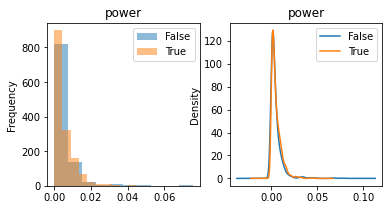

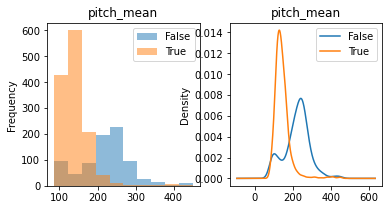

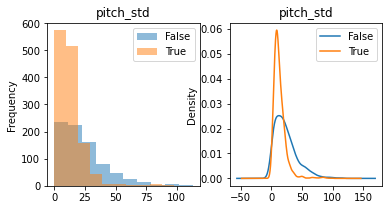

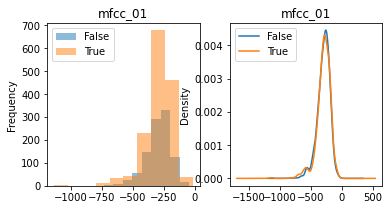

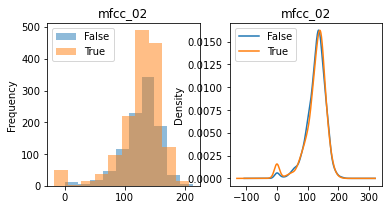

...

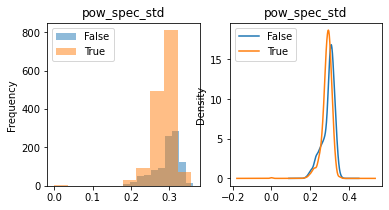

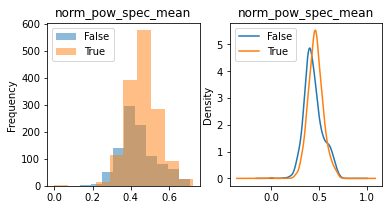

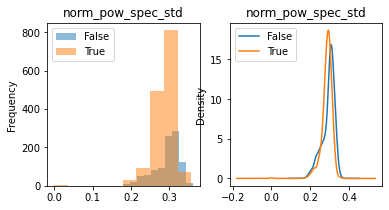

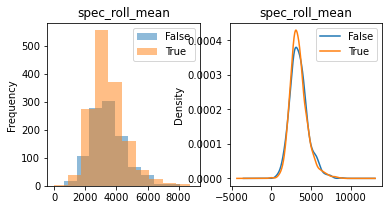

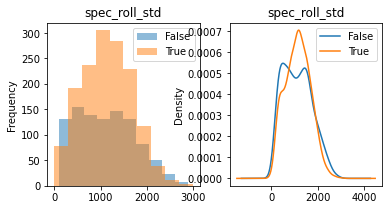

In [ ]:
%matplotlib inline
for col in full_df.columns[:-5]:
    fig, (a1, a2, ) = plt.subplots(1, 2, figsize = (6, 3))
    full_df.groupby('male')[col].plot(ax=a1, kind='hist', logy=False, alpha=0.5, title=col, legend=True)
    full_df.groupby('male')[col].plot(ax=a2, kind='density', logy=False, alpha=1.0, title=col, legend=True)
    plt.show()

By grouping each canditate feature into two subgroups and plotting the historgrams of the frequencies and the density plot we can see that pitch_mean and pitch_std have a clear differences. 

I would expect that this is a meaningful signal as sterotypically we would expect women to have higher voices, and to some extent, be more expressive than a male voice. Again this is sterotypical, but a greater variation in pitch would be expected in a more expressive voice.

pow_spec_mean & pow_spec_std (and the normalised versions norm_pow_spec_mean etc) also show differences in the densities between the sexes. 

spec_roll_mean and std also show minor differences, as do most of the mfcc values but these are not as pronounced. 

Looking solely at this data we would expect pitch_mean, pitch_std to be very promising canditates. 
With pow_spec_mean and pow_spec_std, and the mfcc variables being of interest

### 7.08 Normalise the dataset for the remaining visualisations
- apply a standard scaler to the dataset
- Check that the normalisation has left the histogram and density plots unchanged 

From our experience with the basic problem, we have identified that the data should be normalised for exploration.
The graphs below show the that underlying structure of the data has not changed, but having all canditate features centered on zero will help for visualising how each feature is distrubuted

In [ ]:
from sklearn.preprocessing import StandardScaler

norm_result = full_df.copy()

scaler = StandardScaler()
scaler.fit(norm_result.iloc[:,0:-5])
norm_result.iloc[:,0:-5] = scaler.transform(norm_result.iloc[:,0:-5])



In [ ]:
%matplotlib inline
for col in norm_result.columns[:-5]:
    fig, (a1, a2, ) = plt.subplots(1, 2, figsize = (6, 3))
    norm_result.groupby('male')[col].plot(ax=a1, kind='hist', logy=False, alpha=0.5, title=col, legend=True)
    norm_result.groupby('male')[col].plot(ax=a2, kind='density', logy=False, alpha=1.0, title=col, legend=True)
    plt.show()

### 7.09 Pairplot each candidate feature along with sexes labels

- Pairplot all of the candidate features against each other, looking for separation between the sexes labels.
- its messy but we are looking only for seperation between the blue and red dots at this stage

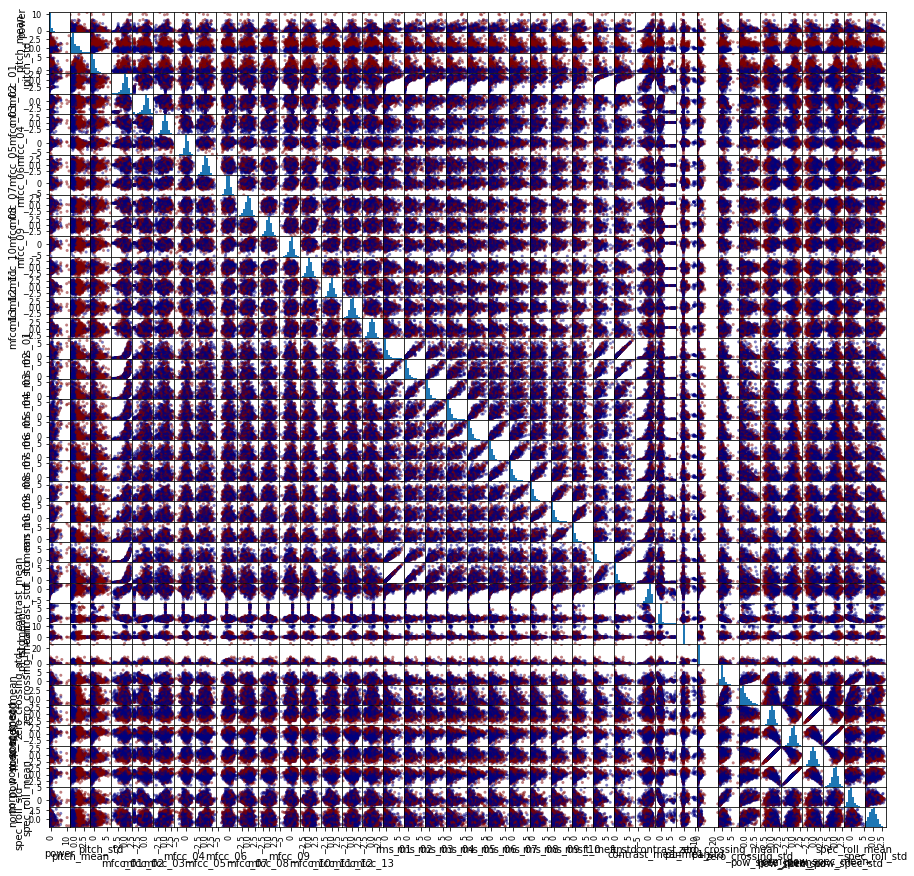

In [ ]:
%matplotlib inline
# create pairplot for the normalised canditate features, use the sexes labels to colour the datapoints
_a = pd.plotting.scatter_matrix(norm_result.iloc[:,:-5], c=sexes,cmap='jet', figsize=(15,15))

**It appears that pitch_mean, pitch_std, pow_spec_mean, pow_spec_std are worth taking a closer look at.**

In the next few cells I will plot each of these four canditate features against all others, this will allow us to see the detail of each pair plot and look for sets of candidates that might work well together to create a prediction space. 

- What we are looking to identify is seperation between red and blue areas which would indicate that our labels will be linearly seperable. 

### 7.10 Explore interesting candidate pair plots in more detail
- Review sub groups of the candidates in scatterplots or pairplots to confirm groupings which show good separation between the sexes. 


### pitch_mean plotted against all other candidates

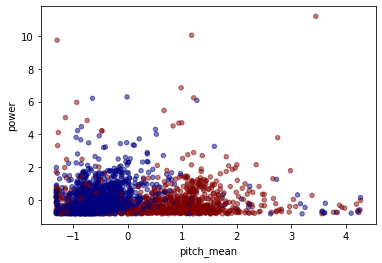

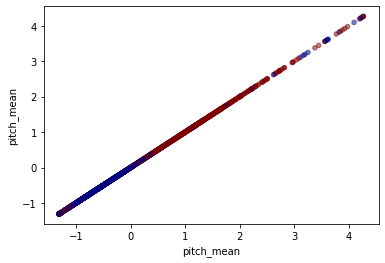

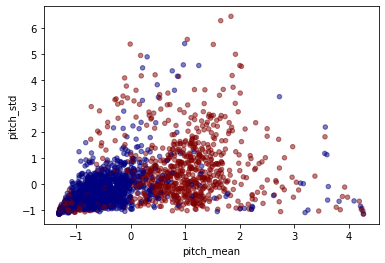

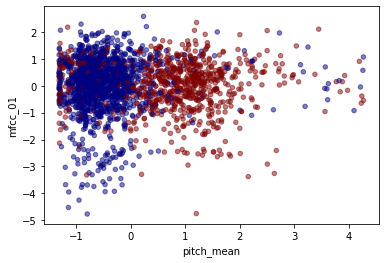

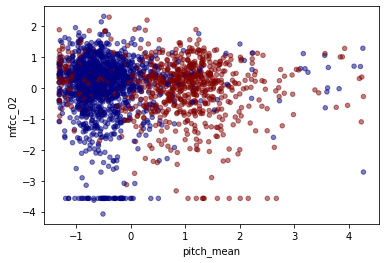

...

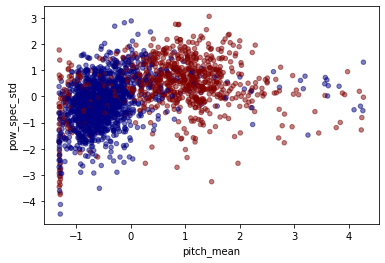

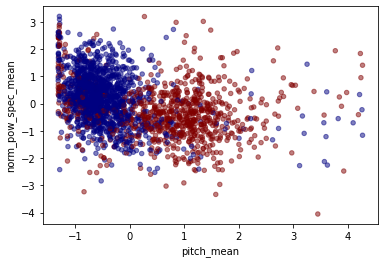

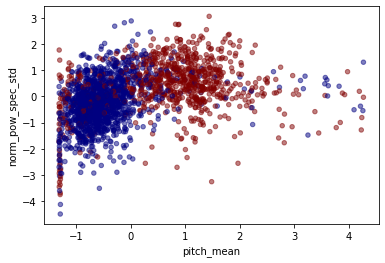

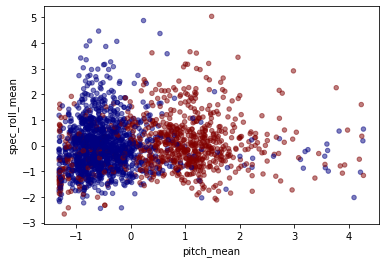

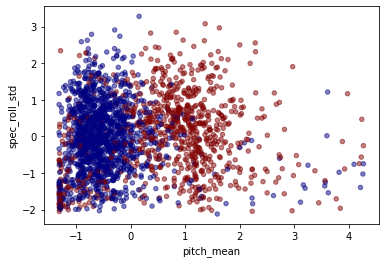

In [ ]:
%matplotlib inline
# each feature plotted against pitch mean
for col in norm_result.columns[:-5]:
    norm_result.iloc[:,:-5].plot(kind='scatter',  x='pitch_mean', y=col,c=sexes,cmap='jet', alpha=0.5,legend=True)
    plt.show()

**Its clear that pitch_mean strongly explains a lot of the seperation.
Of note were the relationships between:**
- pitch_mean and 'pitch_std'
- pitch_mean and most of the MFCC features
- pitch_mean and 'contrast_mean'/'contrast_std'
- pitch_mean and 'spec_roll_std'

### pitch_std plotted against all other candidates

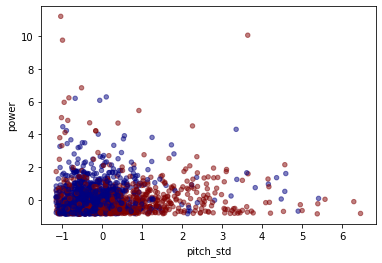

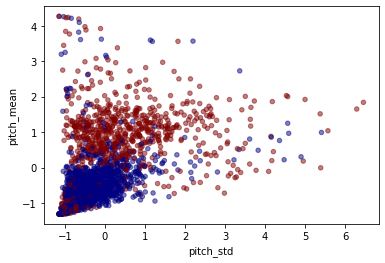

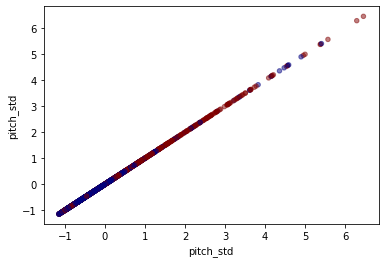

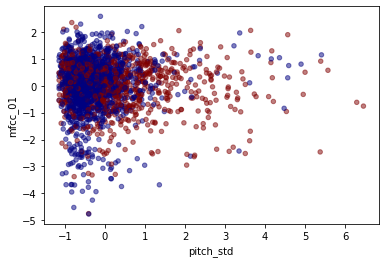

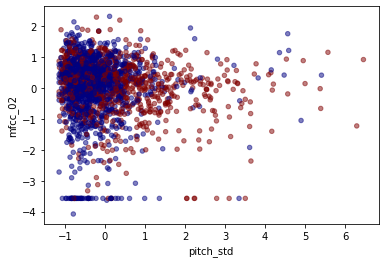

...

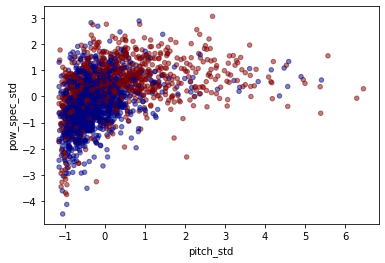

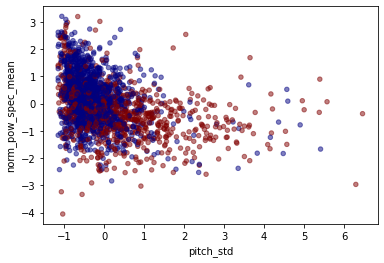

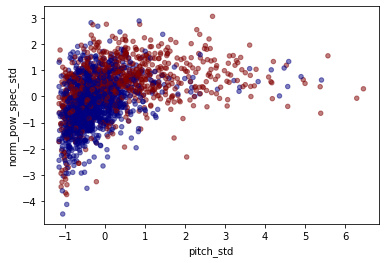

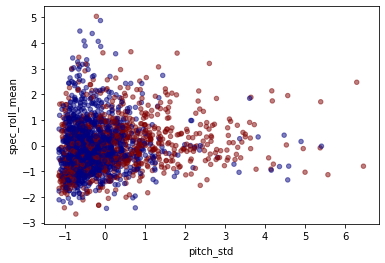

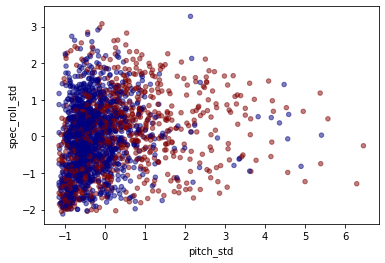

In [ ]:
# each feature plotted against pitch mean
for col in norm_result.columns[:-5]:
    norm_result.iloc[:,:-5].plot(kind='scatter',  x='pitch_std', y=col,c=sexes,cmap='jet', alpha=0.5,legend=True)
    plt.show()

**pitch_std seems to show good seperation when paired with:**
- pitch_mean
- power_spec_std

### pow_spec_mean plotted against all other candidates

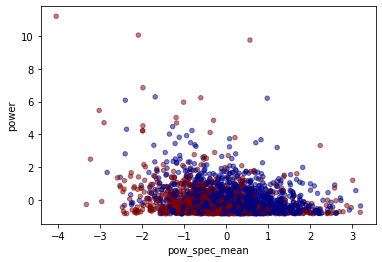

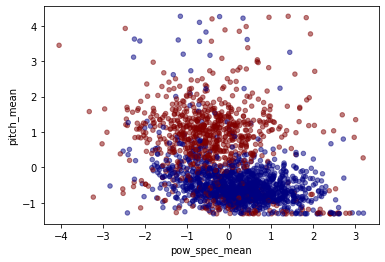

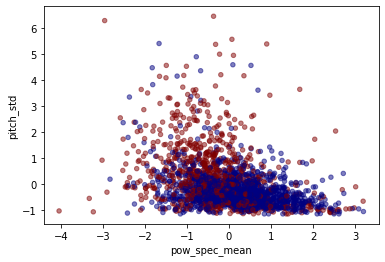

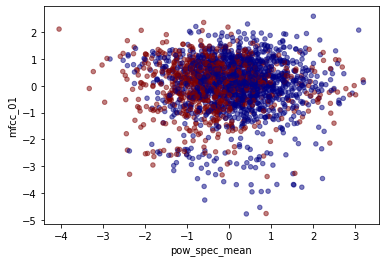

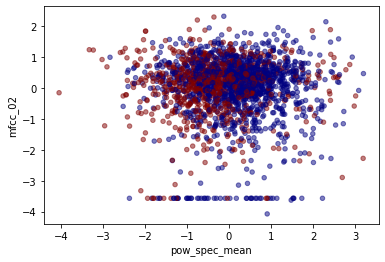

...

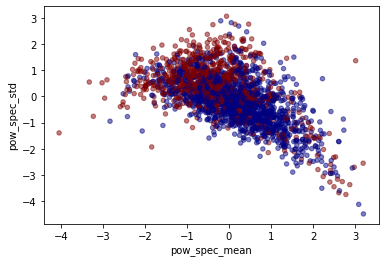

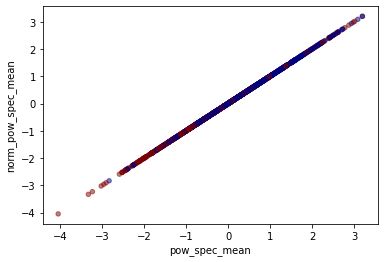

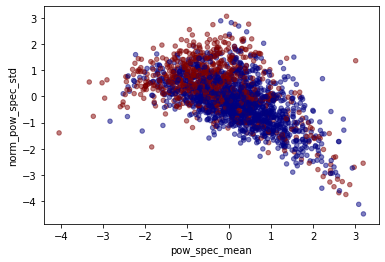

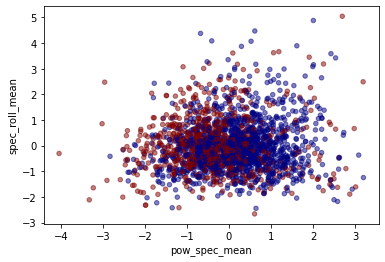

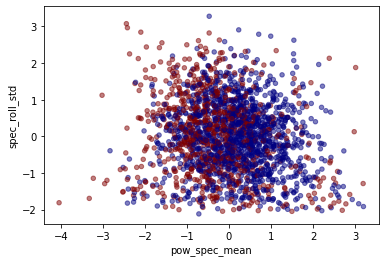

In [ ]:
# each feature plotted against pitch mean
for col in norm_result.columns[:-5]:
    norm_result.iloc[:,:-5].plot(kind='scatter',  x='pow_spec_mean', y=col,c=sexes,cmap='jet', alpha=0.5,legend=True)
    plt.show()

**pow_spec_mean shows some good seperation with:**
- pitch_mean
- contrast_std
- zero_crossing_mean
perhaps
- pow_spec_std

### pow_spec_std plotted against all other candidates

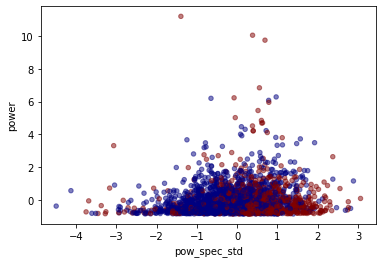

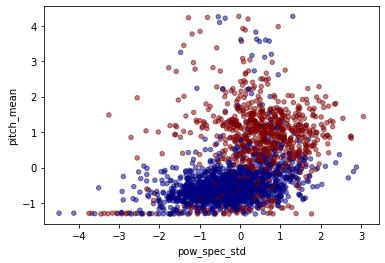

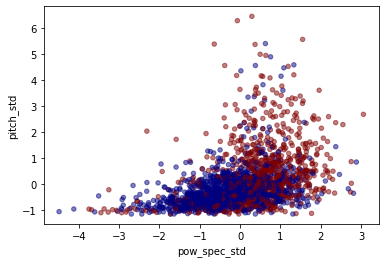

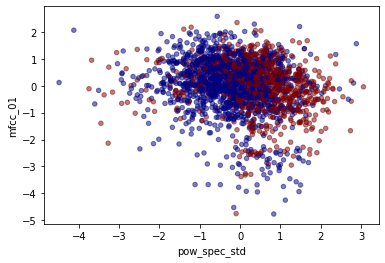

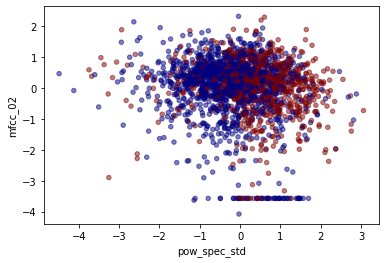

...

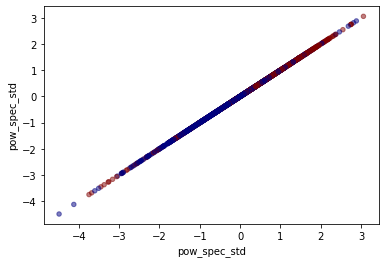

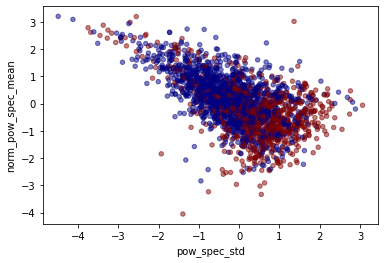

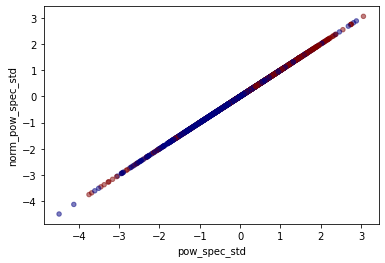

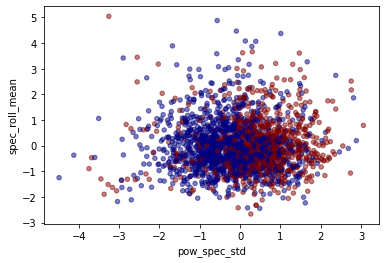

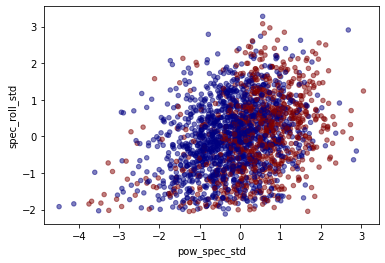

In [ ]:
# each feature plotted against pitch mean
for col in norm_result.columns[:-5]:
    norm_result.iloc[:,:-5].plot(kind='scatter',  x='pow_spec_std', y=col,c=sexes,cmap='jet', alpha=0.5,legend=True)
    plt.show()

**pow_spec_std shows some good seperation with:**
- pitch_mean
- most of the MFCC varaibles
- contrast_mean
- contrast_std
- zero_crossing_mean

perhaps
- pitch_std

### contrast_std has come up a few times, so lets look at this variable 

### contrast_std  plotted against all other candidates

In [ ]:
# each feature plotted against contrast_std
# for col in norm_result.columns[:-5]:
#     norm_result.iloc[:,:-5].plot(kind='scatter',  x='contrast_std', y=col,c=sexes,cmap='jet', alpha=0.5,legend=True)
#     plt.show()

**contrast_std shows some good seperation with:**
- pitch_mean
- power_spec_std
perhaps
- pitch_std

From this exploration it seems that pitch_mean, pitch_std, pow_spec_std and maybe contrast_std have relationships with each other and how they seperate the data. 

lets visualise these four canditates in another set of pairplots. 




### 7.11 Visualise a short-list of the canditates to decide the final set of features
- Reduce the number of features/ create a shortlist of features which are likely to create a prediction space which would maximise separation between the sexes labels. 


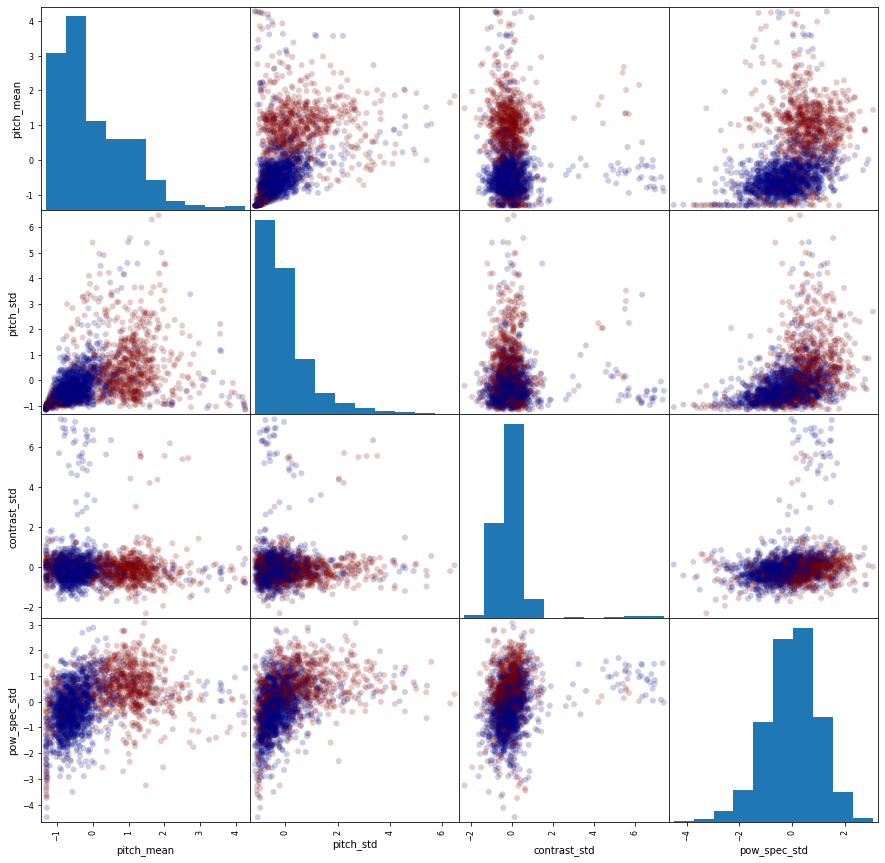

In [ ]:
short_list_cols = ['pitch_mean','pitch_std','contrast_std','pow_spec_std','male']
short_list = norm_result[short_list_cols].copy()
_a = pd.plotting.scatter_matrix(short_list.iloc[:,:-1], c=sexes,cmap='jet',alpha=0.2,marker="O", figsize=(15,15))

The relationships between Pitch_std and contrast_std does not look promising, 
power_spec_std and contrast_std also might be less helpful. 

lets create a 3d visualisation between these three variables to see if the sexes are seperated in a way that is not obvious. 

<IPython.core.display.Javascript object>


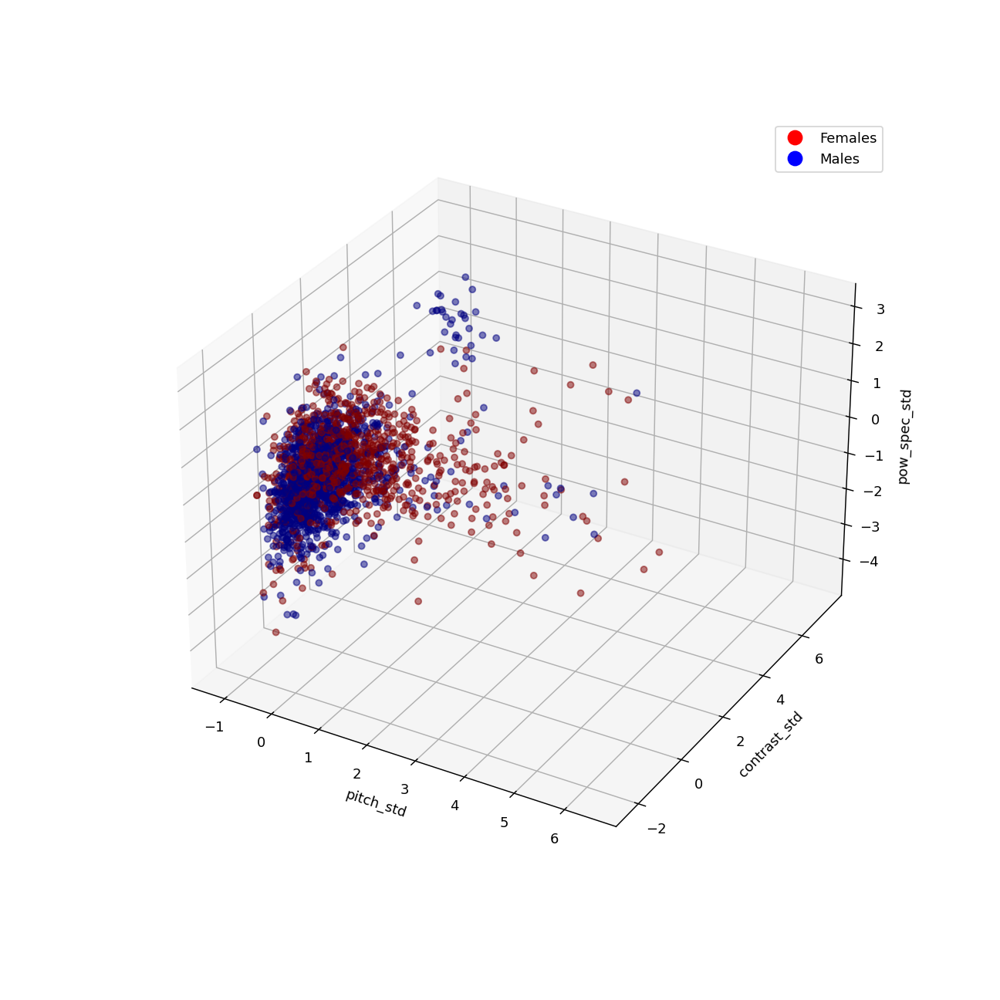

In [ ]:
%matplotlib notebook
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111, projection='3d')
p = ax.scatter(norm_result.iloc[:,2],norm_result.iloc[:,29],norm_result.iloc[:,35],c=sexes,cmap='jet', alpha=0.5)
ax.set_xlabel('pitch_std')
ax.set_ylabel('contrast_std')
ax.set_zlabel('pow_spec_std')
males = mlines.Line2D([],[],color='b', marker='o',markersize=10, linewidth=0, label='Males')
females = mlines.Line2D([],[],color='r', marker='o',markersize=10, linewidth=0,label='Females')
plt.legend(handles=[females, males])
plt.show()



This is not a very helpful predictor space, so I have decided to remove one of these canditates from the list. 
we know that pitch_mean and Pitch_std show a good amount of seperation between our sexes labels
so lets plot these two with either contrast_std or pow_spec_mean

### pitch_mean, pitch_std with contrast_std

the graph shows a good enough predictor space, a little flattened but good enough for use in into model selection

<IPython.core.display.Javascript object>


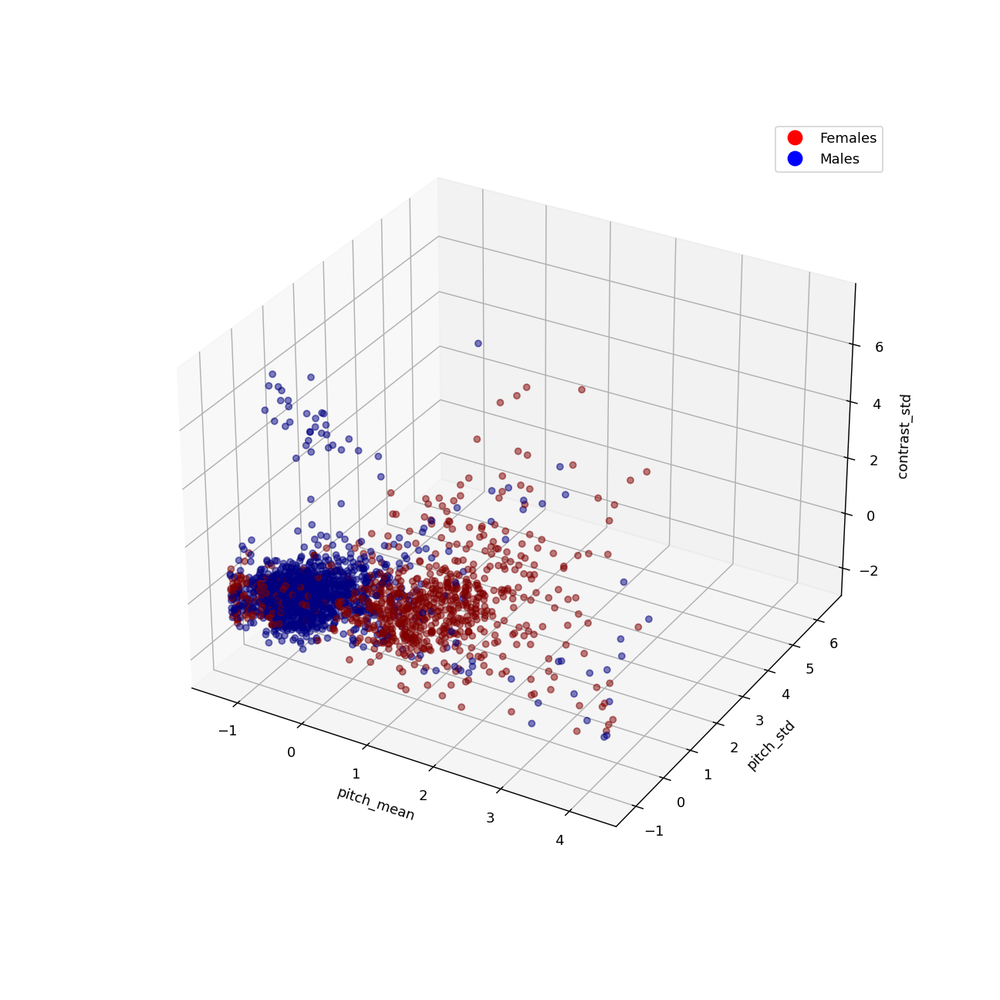

In [ ]:
%matplotlib notebook
#%matplotlib inline
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111, projection='3d')
p = ax.scatter(norm_result.iloc[:,1],norm_result.iloc[:,2],norm_result.iloc[:,29],c=sexes,cmap='jet', alpha=0.5)
ax.set_xlabel('pitch_mean')
ax.set_ylabel('pitch_std')
ax.set_zlabel('contrast_std')
plt.legend(handles=[females, males])
plt.show()

### pitch_mean, pitch_std with pow_spec_std

This is also a good predictor space, it has the datapoints spaced out, which i feel might be better for some models like support vector machines. 

I have decided to take these three forward as my final list of features. 

### 7.12 Decide on final feature set

Final features selected are:
- pitch_mean, 
- pitch_std 
- pow_spec_std

### 7.13 Explore if more transformation would be of benefit

The graph above shows the normalised, untransformed predictor space. 

to explore if transformation via PCA would be of benefit, we can run it through and see what the explained_variance ratio tells us about the three features, and visualise the predictor space again

### How would PCA transformation change the predictor space?

In [ ]:
from sklearn.decomposition import PCA

columns_to_keep = ['pitch_mean','pitch_std','pow_spec_std']
features = norm_result[columns_to_keep].copy()
pca = PCA(n_components=3)
pca.fit(features)
three_features = pca.transform(features)

print(pca.explained_variance_ratio_)
print(pca.singular_values_)
print(pca.components_)

[0.59847005 0.20753558 0.19399436]
[61.54929277 36.24500297 35.04260719]
[[ 0.57479027  0.58666391  0.57047489]
 [ 0.64917958  0.09750277 -0.75436005]
 [-0.4981787   0.80393947 -0.32480659]]


<IPython.core.display.Javascript object>


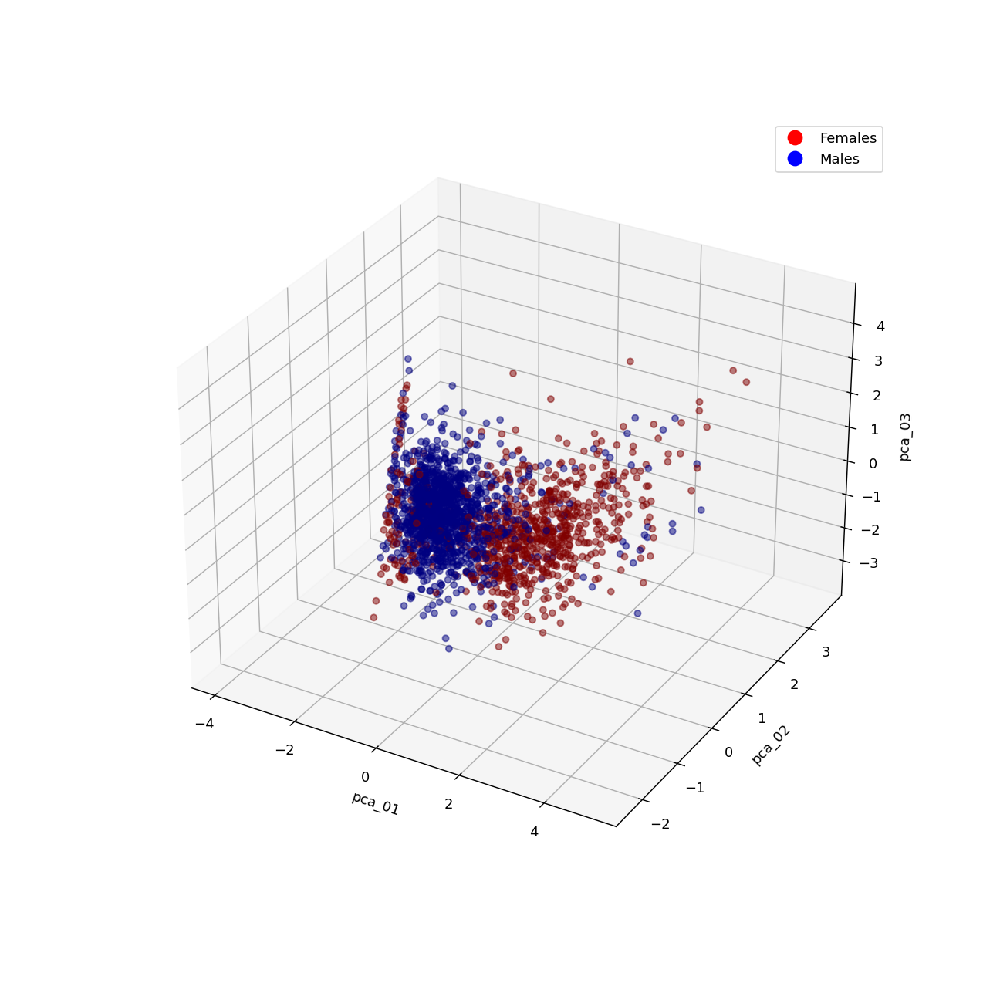

In [ ]:
%matplotlib notebook
#%matplotlib inline
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111, projection='3d')

p = ax.scatter(three_features[:,0],three_features[:,1],three_features[:,2],c=sexes,cmap='jet', alpha=0.5)
ax.set_xlabel('pca_01')
ax.set_ylabel('pca_02')
ax.set_zlabel('pca_03')
plt.legend(handles=[females, males])
plt.show()

**Looking at this, I don't feel PCA adds anything to the prediction space** 
- we already have a good seperation between sexes, and adding a PCA without seeing a benefit feels unnecessary.  

### 7.14 define the final data processing pipeline to be used for model selection
- Create a dataset ready for model selection experiments


### At this stage we are now ready to select the best model for features selected and our problem. 

- In the above section I have processed 2500 audio samples, creating around 40 canditate features for assessment. 
- I have removed any samples with a value of 0.0 for pitch_mean or pitch_std. 
- By looking at the distribution of each canditate feature when grouped by sexes label, we have removed canditates with little to no variation. 
- By pairplotting the remaining canditate features against each other, and colour mapping against sexes label we identified 4 canditate features which entered the short_list. 
- finally by pairploting again and exploring different feature sets in 3d space, we were able to identify the best three features which appeared to have a harmonious effect in shaping the predictive space. 

- What if we had had more than three features in the end? 
I think the approach still would have worked, if we had 8 shortlisted canditate features, I would look to keep features which kept good seperation of the labels. 
It appears that the density plots were the quick way to idnetify this without the need for too much visualisations. But I will say I feel confident in doing this at pace in the future because of the work put in on this project. 

### We have now defined our data pipeline and transformation pipeline as:
- Manually create the sexes label
- Identify the best 1.5 second subsample of each audio file
- extract the audio features from the selected sub sample
- remove/ignore any sample without pitch_mean or pitch_std 
- normalise the data using a stand scaler. 
- the final features used in this data pipeline are:
    - pitch_mean
    - pitch_std
    - pow_spec_std

### create a dataset for use in model selection experiments

In [ ]:
feature_set = ['pitch_mean', 'pitch_std', 'pow_spec_std', 'male']
finalset = full_df[feature_set].copy()
display(finalset)

,pitch_mean,pitch_std,pow_spec_std,male
0,325.236666,28.786019,0.312440,False
1,231.461977,40.139432,0.314011,False
2,124.816188,13.131737,0.295595,True
3,224.327978,39.453351,0.299755,False
4,240.915619,15.027745,0.333484,False
...,...,...,...,...
2494,87.974646,2.132672,0.235895,False
2495,169.608125,18.657903,0.325355,True
2497,130.582934,6.261421,0.292370,True
2498,128.840731,3.493958,0.268440,True


# 8 Results

Carry out your experiments here, explain your results.

### 8.01 Split the un-normalized dataset into train and test sets
- Use a 70/30 split holding back 30% of the samples for final evaluation. 
- Take 70% of the data for model evaluation. 


In [ ]:
from sklearn import svm
from sklearn.model_selection import train_test_split

X_train_unscaled, X_val_unscaled, y_train, y_val = train_test_split(finalset.iloc[:,:-1].to_numpy(),finalset.iloc[:,-1].to_numpy(),t)
print(X_train_unscaled.shape, X_val_unscaled.shape, y_train.shape, y_val.shape)
print(y_train[:10])


(1477, 3) (633, 3) (1477,) (633,)
[False False False  True False False  True  True False  True]


### 8.02 Use a standard scaler to normalise the data
- This will re-create the predictor space we have visualised, but with new mean and standard deviation based only the X_train dataset
- this ensures that the mean or Std of the whole set does not leak into the model testing. 
- all models will be fitted using the mean and std of the 70% train dataset. 

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(X_train_unscaled)
X_train = scaler.transform(X_train_unscaled)

### 8.03 create helper functions for the model testing
- cross_val_predict() uses sklearn KFold() to complete k fold cross validation, but also records the predicted labels from each fold when it is being used as validators. This allows us to get a confusion matrix off the entire X_train dataset.  
- matrix_and_results() takes the actual labels and predicted labels from cross_val_predict(), turning them into a confusion matrix, sensitivity, specificity, positive predictive value and negative predictive value. 


In [ ]:
# after https://towardsdatascience.com/how-to-plot-a-confusion-matrix-from-a-k-fold-cross-validation-b607317e9874
import copy as cp
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
%matplotlib inline
import seaborn as sns
from typing import Tuple
from sklearn.metrics import confusion_matrix

def cross_val_predict(model, kfold : KFold, X : np.array, y : np.array) -> Tuple[np.array, np.array]:
    # create variables for kfold to use
    model_ = cp.deepcopy(model)
    number_of_labels = len(np.unique(y))
    actual_labels = np.empty([0], dtype=int)
    predicted_labels = np.empty([0], dtype=int)

    # the the kfold.split to biuld the full list of actual and predicted labels
    # gives the indexs for this fold
    for train_indexs, test_indexs in kfold.split(X):

        train_X, train_y, test_X, test_y = X[train_indexs], y[train_indexs], X[test_indexs], y[test_indexs]
        # get the labels from the y_train
        actual_labels = np.append(actual_labels, test_y)
        # make predictions for is fold's indexs
        model_.fit(train_X, train_y)
        predicted_labels = np.append(predicted_labels, model_.predict(test_X))
    
    # return the full list of actual and predicted
    return actual_labels, predicted_labels



In [ ]:
def matrix_and_results(actual: np.array, predicted: np.array, sorted_labels : list):
    
    matrix = confusion_matrix(actual, predicted, labels=sorted_labels)
    
    plt.figure(figsize=(5,3))
    sns.heatmap(matrix, annot=True, xticklabels=sorted_labels, yticklabels=sorted_labels, cmap="Blues", fmt="g")
    plt.xlabel('Predicted'); plt.ylabel('Actual'); plt.title('Confusion Matrix')

    plt.show()
    
    true_postives = matrix[0][0]
    true_negatives = matrix[1][1]
    false_postives = matrix[0][1]
    false_negatives = matrix[1][0]
    print('true_postives', true_postives)
    print('true_negatives', true_negatives)
    print('false_postives', false_postives)
    print('false_negatives', false_negatives)
    sensitivity = true_postives / (true_postives+false_negatives)
    print('sensitivity',sensitivity, "to predict male, when they are really male")
    specificity = true_negatives / (true_negatives+false_postives)
    print('specificity',specificity , "to predict female, when they are really female")
    ppv = true_postives / (true_postives+false_postives)
    print('Postive Predictive value',ppv , "that a predicted male is really male")
    npv = true_negatives / (true_negatives+false_negatives)
    print('Negative Predictive value',npv , "that a predicted female is really female")
    print('')
    print('')

### an example of the type of output we can expect from each model training and cross validation

SVC(C=1.5, gamma=1.5, random_state=0)
0.86 accuracy with a standard deviation of 0.02
0.8591731562070546 0.023245163438322773


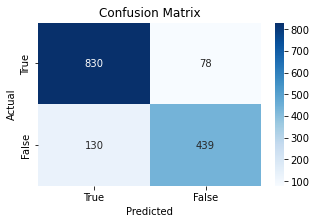

true_postives 830
true_negatives 439
false_postives 78
false_negatives 130
sensitivity 0.8645833333333334 to predict male, when they are really male
specificity 0.8491295938104448 to predict female, when they are really female
Postive Predictive value 0.9140969162995595 that a predicted male is really male
Negative Predictive value 0.7715289982425307 that a predicted female is really female




In [ ]:
%matplotlib inline
from sklearn.svm import SVC
model = svm.SVC(C=1.5,gamma=1.5, random_state=0)
kfold = KFold(n_splits=5, random_state=0, shuffle=True)
cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='accuracy')
print(model)
print("%0.2f accuracy with a standard deviation of %0.2f" % (cv_results.mean(), cv_results.std()))
print(cv_results.mean(), cv_results.std())

actual, predicted = cross_val_predict(model, kfold, X_train, y_train)

matrix_and_results(actual, predicted, [True, False])

## The next section of model evaluation will contain the following steps

### 8.04 Use k-fold cross validation to evaluate different models
- I have decided on a 5 fold cross validation strategy
- I have implemented a function which manages this process, but also keeps track of the true vs predicted labels whilst running 5 fold cross validation; these will be used in the next step of the training.
- print out the average accuracy and standard deviation of the model based on 5 fold validation. 

### 8.05 Calculate the confusion matrix for each model evaluation
- Take the true vs predicted labels for each model, calculate the confusion matric, along with sensitivity, specificity, positive predictive value and negative predictive value. 

### 8.06 Explore different hyper parameters of K-nearest_neighbour, Random Forrest Classifier, & Support Vector Machine models
- using the two sections above set up iterations of models which have hyper parameters.
- for K-nearest-Neighbour use odd numbers from 1 - 17.
- for C-Support Vector Classification loop through different C values and gamma values of the default 'rbf' and 'poly' kernels
- for Random Forest classifier change the number of estimators using 1, 3, 5, 10, 15, 20, 25, 50 and the default 100

### 8.07 Review PPV and NPV of models looking for the best all-round performing models
- After running training these models and using 5 fold cross validation to calculate the confusion matrix, 
- evaluate the best model from each family, and select the best 2 performing models. 
- Best performing will have a good agreement between Positive predictive value (for male voices), and negative predictive value (for female voices) and a high level of overall accuracy
- The goal is to achieve as little bias towards males as possible, given that more of the data is male voices. 


## Model evaluations

### 8.08 LinearSVC

LinearSVC(max_iter=5000, random_state=0, tol=1e-05)
0.85 accuracy with a standard deviation of 0.02
0.8463124141090242 0.019670970205121485


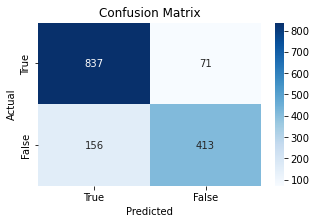

true_postives 837
true_negatives 413
false_postives 71
false_negatives 156
sensitivity 0.8429003021148036 to predict male, when they are really male
specificity 0.8533057851239669 to predict female, when they are really female
Postive Predictive value 0.9218061674008811 that a predicted male is really male
Negative Predictive value 0.7258347978910369 that a predicted female is really female




In [ ]:
%matplotlib inline
from sklearn.svm import LinearSVC
model = LinearSVC(random_state=0, tol=1e-5, max_iter=5000)
kfold = KFold(n_splits=5, random_state=0, shuffle=True)
cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='accuracy')
print(model)
print("%0.2f accuracy with a standard deviation of %0.2f" % (cv_results.mean(), cv_results.std()))
print(cv_results.mean(), cv_results.std())

actual, predicted = cross_val_predict(model, kfold, X_train, y_train)

matrix_and_results(actual, predicted, [True, False])

**Discussion** 
The linearSVC has an accuracy of 85%, 
a postive predictive value (that a predicted male is indeed a male) of 92%
a negative predictive value (that a predicted female is indeed a female) of 72%
the difference between predictive values of males and females is 20%

Overall this model does not meet our success criteria as the difference between predictive value between males and females is large. 

### 8.09 KNeighborsClassifier (with hyperparameter selection)

KNeighborsClassifier(n_neighbors=1)
0.80 accuracy with a standard deviation of 0.02


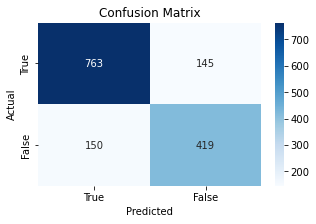

true_postives 763
true_negatives 419
false_postives 145
false_negatives 150
sensitivity 0.8357064622124863 to predict male, when they are really male
specificity 0.7429078014184397 to predict female, when they are really female
Postive Predictive value 0.8403083700440529 that a predicted male is really male
Negative Predictive value 0.7363796133567663 that a predicted female is really female


KNeighborsClassifier(n_neighbors=3)
0.84 accuracy with a standard deviation of 0.02


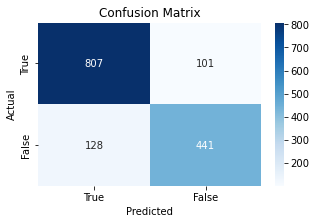

true_postives 807
true_negatives 441
false_postives 101
false_negatives 128
sensitivity 0.8631016042780749 to predict male, when they are really male
specificity 0.8136531365313653 to predict female, when they are really female
Postive Predictive value 0.8887665198237885 that a predicted male is really male
Negative Predictive value 0.7750439367311072 that a predicted female is really female


KNeighborsClassifier()
0.86 accuracy with a standard deviation of 0.02


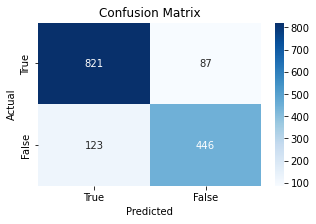

true_postives 821
true_negatives 446
false_postives 87
false_negatives 123
sensitivity 0.8697033898305084 to predict male, when they are really male
specificity 0.8367729831144465 to predict female, when they are really female
Postive Predictive value 0.9041850220264317 that a predicted male is really male
Negative Predictive value 0.7838312829525483 that a predicted female is really female


KNeighborsClassifier(n_neighbors=7)
0.86 accuracy with a standard deviation of 0.02


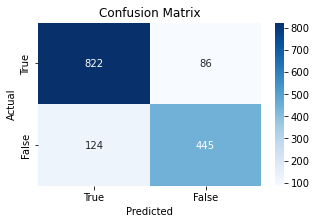

true_postives 822
true_negatives 445
false_postives 86
false_negatives 124
sensitivity 0.86892177589852 to predict male, when they are really male
specificity 0.8380414312617702 to predict female, when they are really female
Postive Predictive value 0.9052863436123348 that a predicted male is really male
Negative Predictive value 0.7820738137082601 that a predicted female is really female


KNeighborsClassifier(n_neighbors=9)
0.85 accuracy with a standard deviation of 0.01


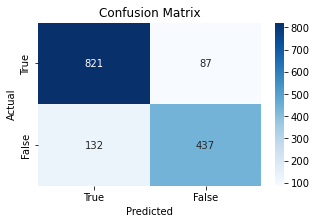

true_postives 821
true_negatives 437
false_postives 87
false_negatives 132
sensitivity 0.8614900314795383 to predict male, when they are really male
specificity 0.833969465648855 to predict female, when they are really female
Postive Predictive value 0.9041850220264317 that a predicted male is really male
Negative Predictive value 0.7680140597539543 that a predicted female is really female


KNeighborsClassifier(n_neighbors=11)
0.85 accuracy with a standard deviation of 0.02


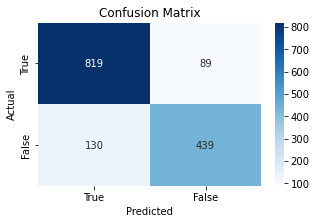

true_postives 819
true_negatives 439
false_postives 89
false_negatives 130
sensitivity 0.863013698630137 to predict male, when they are really male
specificity 0.8314393939393939 to predict female, when they are really female
Postive Predictive value 0.9019823788546255 that a predicted male is really male
Negative Predictive value 0.7715289982425307 that a predicted female is really female


KNeighborsClassifier(n_neighbors=13)
0.86 accuracy with a standard deviation of 0.01


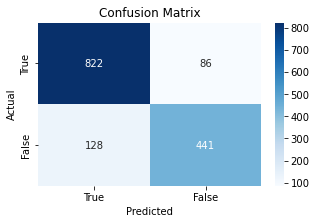

true_postives 822
true_negatives 441
false_postives 86
false_negatives 128
sensitivity 0.8652631578947368 to predict male, when they are really male
specificity 0.8368121442125237 to predict female, when they are really female
Postive Predictive value 0.9052863436123348 that a predicted male is really male
Negative Predictive value 0.7750439367311072 that a predicted female is really female


KNeighborsClassifier(n_neighbors=15)
0.85 accuracy with a standard deviation of 0.02


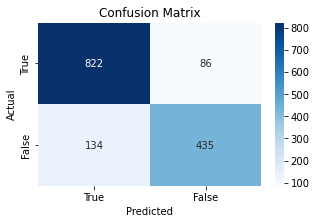

true_postives 822
true_negatives 435
false_postives 86
false_negatives 134
sensitivity 0.8598326359832636 to predict male, when they are really male
specificity 0.8349328214971209 to predict female, when they are really female
Postive Predictive value 0.9052863436123348 that a predicted male is really male
Negative Predictive value 0.7644991212653779 that a predicted female is really female


KNeighborsClassifier(n_neighbors=17)
0.85 accuracy with a standard deviation of 0.03


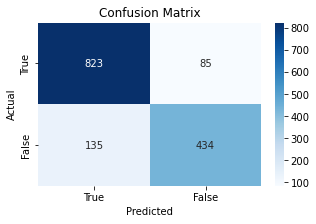

true_postives 823
true_negatives 434
false_postives 85
false_negatives 135
sensitivity 0.8590814196242171 to predict male, when they are really male
specificity 0.8362235067437379 to predict female, when they are really female
Postive Predictive value 0.9063876651982379 that a predicted male is really male
Negative Predictive value 0.7627416520210897 that a predicted female is really female




In [ ]:

import warnings
warnings.filterwarnings(action='ignore', category=FutureWarning) # setting ignore as a parameter and further adding category
%matplotlib inline

from sklearn.neighbors import KNeighborsClassifier
knum = [1, 3, 5, 7, 9, 11, 13, 15, 17]
for k in knum:
    model = KNeighborsClassifier(n_neighbors=k)
    model.fit(X_train, y_train)

    kfold = KFold(n_splits=5, random_state=0, shuffle=True)
    cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='accuracy')
    print(model)
    print("%0.2f accuracy with a standard deviation of %0.2f" % (cv_results.mean(), cv_results.std()))
    actual_classes, predicted_classes = cross_val_predict(model, kfold, X_train, y_train)
    matrix_and_results(actual_classes, predicted_classes, [True, False])



The best model from this family is:

KNeighborsClassifier(n_neighbors=9)
- see the cell below for the output of this model

**Discussion** 
- The KNeighborsClassifier has an accuracy of 85%, 
- a postive predictive value (that a predicted male is indeed a male) of 90.4%
- a negative predictive value (that a predicted female is indeed a female) of 76.8%
- the difference between predictive values of males and females is 13.6%

This model **does not meet our success criteria** as the difference between predictive value between males and females is large. 



KNeighborsClassifier(n_neighbors=9)
0.85 accuracy with a standard deviation of 0.01


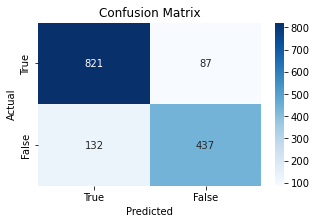

true_postives 821
true_negatives 437
false_postives 87
false_negatives 132
sensitivity 0.8614900314795383 to predict male, when they are really male
specificity 0.833969465648855 to predict female, when they are really female
Postive Predictive value 0.9041850220264317 that a predicted male is really male
Negative Predictive value 0.7680140597539543 that a predicted female is really female




In [ ]:
model = KNeighborsClassifier(n_neighbors=9)
model.fit(X_train, y_train)

kfold = KFold(n_splits=5, random_state=0, shuffle=True)
cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='accuracy')
print(model)
print("%0.2f accuracy with a standard deviation of %0.2f" % (cv_results.mean(), cv_results.std()))
actual_classes, predicted_classes = cross_val_predict(model, kfold, X_train, y_train)
matrix_and_results(actual_classes, predicted_classes, [True, False])

### 8.10 RandomForestClassifier (with hyperparameter selection)

RandomForestClassifier(n_estimators=1, random_state=0)
0.79 accuracy with a standard deviation of 0.02


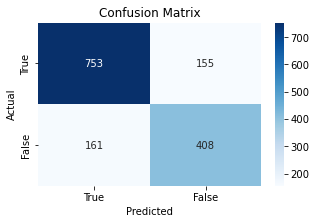

true_postives 753
true_negatives 408
false_postives 155
false_negatives 161
sensitivity 0.8238512035010941 to predict male, when they are really male
specificity 0.7246891651865008 to predict female, when they are really female
Postive Predictive value 0.829295154185022 that a predicted male is really male
Negative Predictive value 0.7170474516695958 that a predicted female is really female


RandomForestClassifier(n_estimators=3, random_state=0)
0.84 accuracy with a standard deviation of 0.02


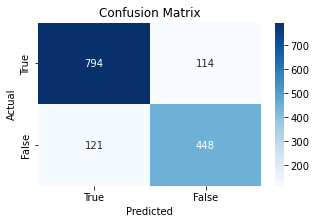

true_postives 794
true_negatives 448
false_postives 114
false_negatives 121
sensitivity 0.8677595628415301 to predict male, when they are really male
specificity 0.797153024911032 to predict female, when they are really female
Postive Predictive value 0.8744493392070485 that a predicted male is really male
Negative Predictive value 0.7873462214411248 that a predicted female is really female


RandomForestClassifier(n_estimators=5, random_state=0)
0.83 accuracy with a standard deviation of 0.03


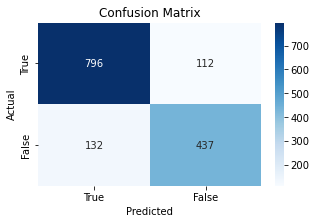

true_postives 796
true_negatives 437
false_postives 112
false_negatives 132
sensitivity 0.8577586206896551 to predict male, when they are really male
specificity 0.7959927140255009 to predict female, when they are really female
Postive Predictive value 0.8766519823788547 that a predicted male is really male
Negative Predictive value 0.7680140597539543 that a predicted female is really female


RandomForestClassifier(n_estimators=10, random_state=0)
0.85 accuracy with a standard deviation of 0.02


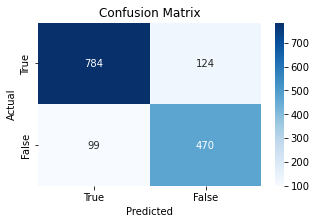

true_postives 784
true_negatives 470
false_postives 124
false_negatives 99
sensitivity 0.8878822197055493 to predict male, when they are really male
specificity 0.7912457912457912 to predict female, when they are really female
Postive Predictive value 0.8634361233480177 that a predicted male is really male
Negative Predictive value 0.8260105448154658 that a predicted female is really female


RandomForestClassifier(n_estimators=15, random_state=0)
0.85 accuracy with a standard deviation of 0.02


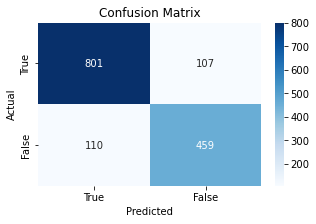

true_postives 801
true_negatives 459
false_postives 107
false_negatives 110
sensitivity 0.8792535675082327 to predict male, when they are really male
specificity 0.8109540636042403 to predict female, when they are really female
Postive Predictive value 0.8821585903083701 that a predicted male is really male
Negative Predictive value 0.8066783831282952 that a predicted female is really female


RandomForestClassifier(n_estimators=20, random_state=0)
0.85 accuracy with a standard deviation of 0.02


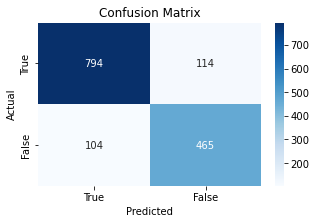

true_postives 794
true_negatives 465
false_postives 114
false_negatives 104
sensitivity 0.8841870824053452 to predict male, when they are really male
specificity 0.8031088082901554 to predict female, when they are really female
Postive Predictive value 0.8744493392070485 that a predicted male is really male
Negative Predictive value 0.8172231985940246 that a predicted female is really female


RandomForestClassifier(n_estimators=25, random_state=0)
0.85 accuracy with a standard deviation of 0.02


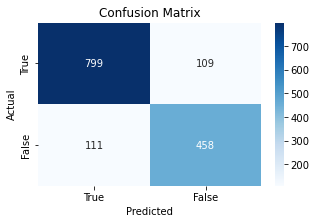

true_postives 799
true_negatives 458
false_postives 109
false_negatives 111
sensitivity 0.878021978021978 to predict male, when they are really male
specificity 0.8077601410934744 to predict female, when they are really female
Postive Predictive value 0.8799559471365639 that a predicted male is really male
Negative Predictive value 0.804920913884007 that a predicted female is really female


RandomForestClassifier(n_estimators=50, random_state=0)
0.84 accuracy with a standard deviation of 0.02


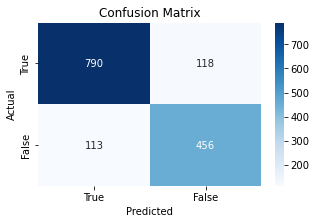

true_postives 790
true_negatives 456
false_postives 118
false_negatives 113
sensitivity 0.8748615725359912 to predict male, when they are really male
specificity 0.794425087108014 to predict female, when they are really female
Postive Predictive value 0.8700440528634361 that a predicted male is really male
Negative Predictive value 0.8014059753954306 that a predicted female is really female


RandomForestClassifier(random_state=0)
0.85 accuracy with a standard deviation of 0.02


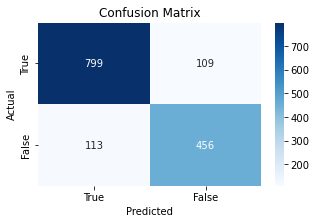

true_postives 799
true_negatives 456
false_postives 109
false_negatives 113
sensitivity 0.8760964912280702 to predict male, when they are really male
specificity 0.8070796460176991 to predict female, when they are really female
Postive Predictive value 0.8799559471365639 that a predicted male is really male
Negative Predictive value 0.8014059753954306 that a predicted female is really female




In [ ]:
from sklearn.model_selection import KFold, cross_val_score
from sklearn.ensemble import RandomForestClassifier
n_estimators = [1, 3, 5, 10, 15, 20, 25, 50, 100]
for estimator in n_estimators:
    
    model = RandomForestClassifier(n_estimators=estimator , random_state=0)
    kfold = KFold(n_splits=5, random_state=0, shuffle=True)
    cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='accuracy')
    print(model)
    print("%0.2f accuracy with a standard deviation of %0.2f" % (cv_results.mean(), cv_results.std()))
    actual_classes, predicted_classes = cross_val_predict(model, kfold, X_train, y_train)
    matrix_and_results(actual_classes, predicted_classes, [True, False])

The best model from this family is:

RandomForestClassifier(n_estimators=10, random_state=0)
- see the cell below the the output of this model

**Discussion** 
- The RandomForestClassifier has an accuracy of 85%, 
- a postive predictive value (that a predicted male is indeed a male) of 86.3%
- a negative predictive value (that a predicted female is indeed a female) of 82.6%
- the difference between predictive values of males and females is 3.7%

This model **meets our success criteria** as the difference between predictive value between males and females is low. 


RandomForestClassifier(n_estimators=10, random_state=0)
0.85 accuracy with a standard deviation of 0.02


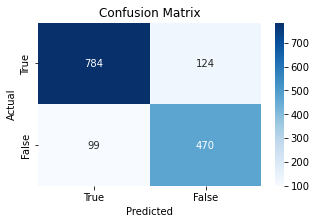

true_postives 784
true_negatives 470
false_postives 124
false_negatives 99
sensitivity 0.8878822197055493 to predict male, when they are really male
specificity 0.7912457912457912 to predict female, when they are really female
Postive Predictive value 0.8634361233480177 that a predicted male is really male
Negative Predictive value 0.8260105448154658 that a predicted female is really female




In [ ]:
model = RandomForestClassifier(n_estimators=10 , random_state=0)
kfold = KFold(n_splits=5, random_state=0, shuffle=True)
cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='accuracy')
print(model)
print("%0.2f accuracy with a standard deviation of %0.2f" % (cv_results.mean(), cv_results.std()))
actual_classes, predicted_classes = cross_val_predict(model, kfold, X_train, y_train)
matrix_and_results(actual_classes, predicted_classes, [True, False])

### 8.11 C-Support Vector Classification

C= 0.5 Gamma= 0.2
SVC(C=0.5, gamma=0.2)
0.85 accuracy with a standard deviation of 0.02
0.8523980760421438 0.017005069885915533


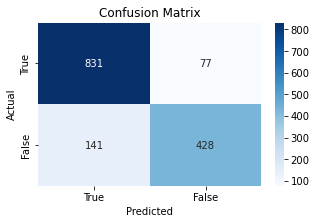

true_postives 831
true_negatives 428
false_postives 77
false_negatives 141
sensitivity 0.8549382716049383 to predict male, when they are really male
specificity 0.8475247524752475 to predict female, when they are really female
Postive Predictive value 0.9151982378854625 that a predicted male is really male
Negative Predictive value 0.7521968365553603 that a predicted female is really female


C= 0.5 Gamma= 0.5
SVC(C=0.5, gamma=0.5)
0.85 accuracy with a standard deviation of 0.02
0.8544342647732478 0.015608822957075233


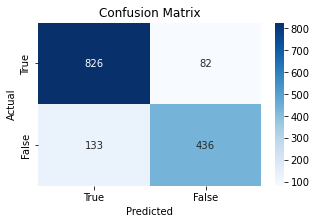

true_postives 826
true_negatives 436
false_postives 82
false_negatives 133
sensitivity 0.8613138686131386 to predict male, when they are really male
specificity 0.8416988416988417 to predict female, when they are really female
Postive Predictive value 0.9096916299559471 that a predicted male is really male
Negative Predictive value 0.7662565905096661 that a predicted female is really female


C= 0.5 Gamma= 1.0
SVC(C=0.5, gamma=1.0)
0.86 accuracy with a standard deviation of 0.02
0.855105359596885 0.01890718918881611


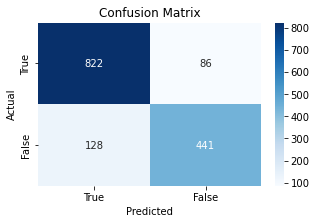

true_postives 822
true_negatives 441
false_postives 86
false_negatives 128
sensitivity 0.8652631578947368 to predict male, when they are really male
specificity 0.8368121442125237 to predict female, when they are really female
Postive Predictive value 0.9052863436123348 that a predicted male is really male
Negative Predictive value 0.7750439367311072 that a predicted female is really female


C= 0.5 Gamma= 1.5
SVC(C=0.5, gamma=1.5)
0.86 accuracy with a standard deviation of 0.02
0.8598419606046726 0.020907599870074886


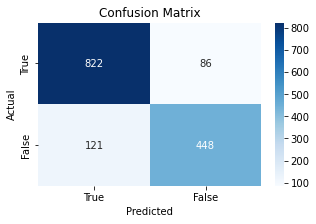

true_postives 822
true_negatives 448
false_postives 86
false_negatives 121
sensitivity 0.8716861081654295 to predict male, when they are really male
specificity 0.8389513108614233 to predict female, when they are really female
Postive Predictive value 0.9052863436123348 that a predicted male is really male
Negative Predictive value 0.7873462214411248 that a predicted female is really female


C= 0.5 Gamma= 2.0
SVC(C=0.5, gamma=2.0)
0.86 accuracy with a standard deviation of 0.02
0.8598419606046726 0.020907599870074886


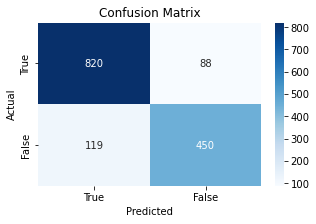

true_postives 820
true_negatives 450
false_postives 88
false_negatives 119
sensitivity 0.873269435569755 to predict male, when they are really male
specificity 0.8364312267657993 to predict female, when they are really female
Postive Predictive value 0.9030837004405287 that a predicted male is really male
Negative Predictive value 0.7908611599297012 that a predicted female is really female


C= 1.5 Gamma= 0.2
SVC(C=1.5, gamma=0.2)
0.85 accuracy with a standard deviation of 0.02
0.8503687585890976 0.015396928565045737


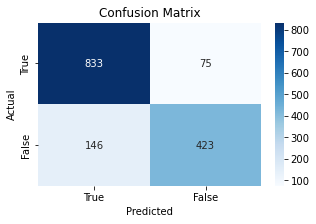

true_postives 833
true_negatives 423
false_postives 75
false_negatives 146
sensitivity 0.8508682328907048 to predict male, when they are really male
specificity 0.8493975903614458 to predict female, when they are really female
Postive Predictive value 0.9174008810572687 that a predicted male is really male
Negative Predictive value 0.7434094903339191 that a predicted female is really female


C= 1.5 Gamma= 0.5
SVC(C=1.5, gamma=0.5)
0.86 accuracy with a standard deviation of 0.02
0.855105359596885 0.0173857191536342


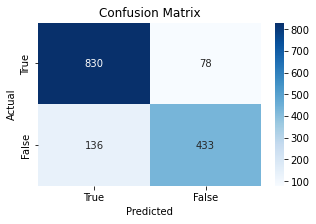

true_postives 830
true_negatives 433
false_postives 78
false_negatives 136
sensitivity 0.8592132505175983 to predict male, when they are really male
specificity 0.8473581213307241 to predict female, when they are really female
Postive Predictive value 0.9140969162995595 that a predicted male is really male
Negative Predictive value 0.7609841827768014 that a predicted female is really female


C= 1.5 Gamma= 1.0
SVC(C=1.5, gamma=1.0)
0.86 accuracy with a standard deviation of 0.02
0.857812643151626 0.02342066992264641


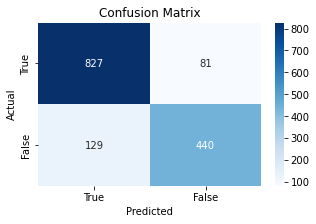

true_postives 827
true_negatives 440
false_postives 81
false_negatives 129
sensitivity 0.8650627615062761 to predict male, when they are really male
specificity 0.8445297504798465 to predict female, when they are really female
Postive Predictive value 0.9107929515418502 that a predicted male is really male
Negative Predictive value 0.773286467486819 that a predicted female is really female


C= 1.5 Gamma= 1.5
SVC(C=1.5, gamma=1.5)
0.86 accuracy with a standard deviation of 0.02
0.8591731562070546 0.023245163438322773


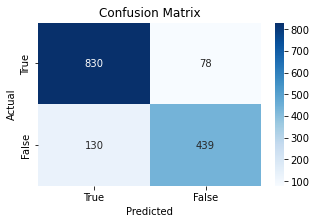

true_postives 830
true_negatives 439
false_postives 78
false_negatives 130
sensitivity 0.8645833333333334 to predict male, when they are really male
specificity 0.8491295938104448 to predict female, when they are really female
Postive Predictive value 0.9140969162995595 that a predicted male is really male
Negative Predictive value 0.7715289982425307 that a predicted female is really female


C= 1.5 Gamma= 2.0
SVC(C=1.5, gamma=2.0)
0.86 accuracy with a standard deviation of 0.02
0.8605290884104443 0.02493887918871473


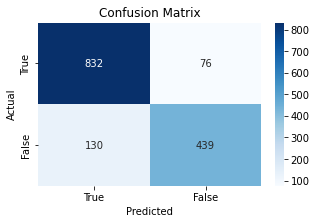

true_postives 832
true_negatives 439
false_postives 76
false_negatives 130
sensitivity 0.8648648648648649 to predict male, when they are really male
specificity 0.8524271844660194 to predict female, when they are really female
Postive Predictive value 0.9162995594713657 that a predicted male is really male
Negative Predictive value 0.7715289982425307 that a predicted female is really female


C= 2.5 Gamma= 0.2
SVC(C=2.5, gamma=0.2)
0.85 accuracy with a standard deviation of 0.01
0.8517224003664682 0.014638120752576375


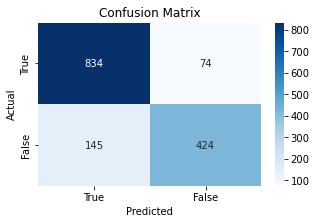

true_postives 834
true_negatives 424
false_postives 74
false_negatives 145
sensitivity 0.8518896833503575 to predict male, when they are really male
specificity 0.8514056224899599 to predict female, when they are really female
Postive Predictive value 0.9185022026431718 that a predicted male is really male
Negative Predictive value 0.7451669595782073 that a predicted female is really female


C= 2.5 Gamma= 0.5
SVC(C=2.5, gamma=0.5)
0.85 accuracy with a standard deviation of 0.02
0.8530760421438387 0.015290973305915577


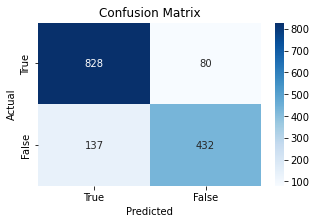

true_postives 828
true_negatives 432
false_postives 80
false_negatives 137
sensitivity 0.8580310880829015 to predict male, when they are really male
specificity 0.84375 to predict female, when they are really female
Postive Predictive value 0.9118942731277533 that a predicted male is really male
Negative Predictive value 0.7592267135325131 that a predicted female is really female


C= 2.5 Gamma= 1.0
SVC(C=2.5, gamma=1.0)
0.86 accuracy with a standard deviation of 0.02
0.8598419606046726 0.022591143758118538


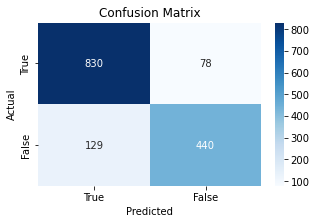

true_postives 830
true_negatives 440
false_postives 78
false_negatives 129
sensitivity 0.8654848800834203 to predict male, when they are really male
specificity 0.8494208494208494 to predict female, when they are really female
Postive Predictive value 0.9140969162995595 that a predicted male is really male
Negative Predictive value 0.773286467486819 that a predicted female is really female


C= 2.5 Gamma= 1.5
SVC(C=2.5, gamma=1.5)
0.86 accuracy with a standard deviation of 0.02
0.8598534127347687 0.02211262094759883


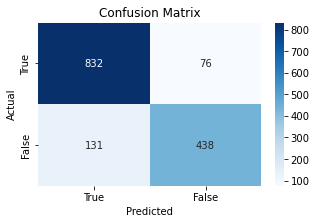

true_postives 832
true_negatives 438
false_postives 76
false_negatives 131
sensitivity 0.8639667705088265 to predict male, when they are really male
specificity 0.8521400778210116 to predict female, when they are really female
Postive Predictive value 0.9162995594713657 that a predicted male is really male
Negative Predictive value 0.7697715289982425 that a predicted female is really female


C= 2.5 Gamma= 2.0
SVC(C=2.5, gamma=2.0)
0.86 accuracy with a standard deviation of 0.02
0.8645945945945946 0.024134806616939293


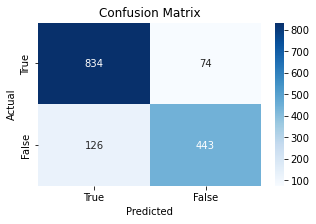

true_postives 834
true_negatives 443
false_postives 74
false_negatives 126
sensitivity 0.86875 to predict male, when they are really male
specificity 0.8568665377176016 to predict female, when they are really female
Postive Predictive value 0.9185022026431718 that a predicted male is really male
Negative Predictive value 0.7785588752196837 that a predicted female is really female


C= 3.5 Gamma= 0.2
SVC(C=3.5, gamma=0.2)
0.85 accuracy with a standard deviation of 0.02
0.8530760421438387 0.018043155119624878


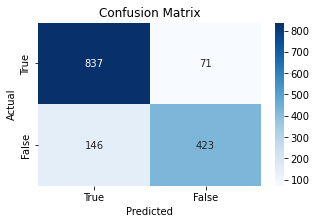

true_postives 837
true_negatives 423
false_postives 71
false_negatives 146
sensitivity 0.8514750762970499 to predict male, when they are really male
specificity 0.8562753036437247 to predict female, when they are really female
Postive Predictive value 0.9218061674008811 that a predicted male is really male
Negative Predictive value 0.7434094903339191 that a predicted female is really female


C= 3.5 Gamma= 0.5
SVC(C=3.5, gamma=0.5)
0.86 accuracy with a standard deviation of 0.02
0.8557924874026568 0.021900167301495972


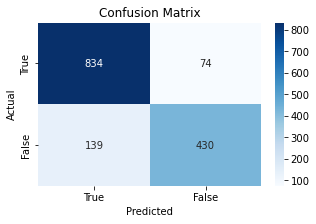

true_postives 834
true_negatives 430
false_postives 74
false_negatives 139
sensitivity 0.8571428571428571 to predict male, when they are really male
specificity 0.8531746031746031 to predict female, when they are really female
Postive Predictive value 0.9185022026431718 that a predicted male is really male
Negative Predictive value 0.7557117750439367 that a predicted female is really female


C= 3.5 Gamma= 1.0
SVC(C=3.5, gamma=1.0)
0.86 accuracy with a standard deviation of 0.02
0.8584928996793405 0.020627604704698176


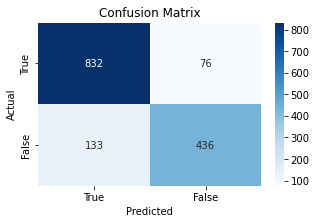

true_postives 832
true_negatives 436
false_postives 76
false_negatives 133
sensitivity 0.8621761658031089 to predict male, when they are really male
specificity 0.8515625 to predict female, when they are really female
Postive Predictive value 0.9162995594713657 that a predicted male is really male
Negative Predictive value 0.7662565905096661 that a predicted female is really female


C= 3.5 Gamma= 1.5
SVC(C=3.5, gamma=1.5)
0.86 accuracy with a standard deviation of 0.02
0.8612047640861199 0.02248607893925879


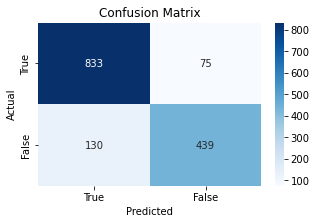

true_postives 833
true_negatives 439
false_postives 75
false_negatives 130
sensitivity 0.8650051921079959 to predict male, when they are really male
specificity 0.8540856031128404 to predict female, when they are really female
Postive Predictive value 0.9174008810572687 that a predicted male is really male
Negative Predictive value 0.7715289982425307 that a predicted female is really female


C= 3.5 Gamma= 2.0
SVC(C=3.5, gamma=2.0)
0.86 accuracy with a standard deviation of 0.02
0.8605359596885019 0.02121174777059904


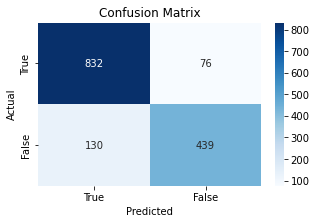

true_postives 832
true_negatives 439
false_postives 76
false_negatives 130
sensitivity 0.8648648648648649 to predict male, when they are really male
specificity 0.8524271844660194 to predict female, when they are really female
Postive Predictive value 0.9162995594713657 that a predicted male is really male
Negative Predictive value 0.7715289982425307 that a predicted female is really female


C= 4.5 Gamma= 0.2
SVC(C=4.5, gamma=0.2)
0.85 accuracy with a standard deviation of 0.02
0.8517246907924875 0.018993454401356375


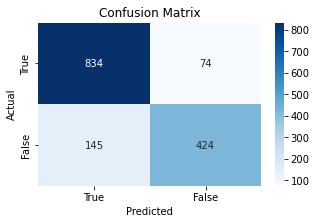

true_postives 834
true_negatives 424
false_postives 74
false_negatives 145
sensitivity 0.8518896833503575 to predict male, when they are really male
specificity 0.8514056224899599 to predict female, when they are really female
Postive Predictive value 0.9185022026431718 that a predicted male is really male
Negative Predictive value 0.7451669595782073 that a predicted female is really female


C= 4.5 Gamma= 0.5
SVC(C=4.5, gamma=0.5)
0.85 accuracy with a standard deviation of 0.02
0.8537585890975722 0.022821350627797294


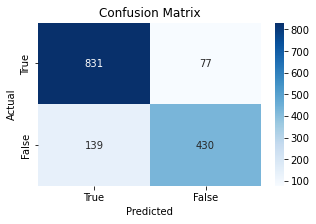

true_postives 831
true_negatives 430
false_postives 77
false_negatives 139
sensitivity 0.856701030927835 to predict male, when they are really male
specificity 0.8481262327416174 to predict female, when they are really female
Postive Predictive value 0.9151982378854625 that a predicted male is really male
Negative Predictive value 0.7557117750439367 that a predicted female is really female


C= 4.5 Gamma= 1.0
SVC(C=4.5, gamma=1.0)
0.86 accuracy with a standard deviation of 0.02
0.8571369674759506 0.02305443825824618


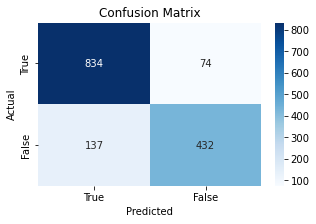

true_postives 834
true_negatives 432
false_postives 74
false_negatives 137
sensitivity 0.858908341915551 to predict male, when they are really male
specificity 0.8537549407114624 to predict female, when they are really female
Postive Predictive value 0.9185022026431718 that a predicted male is really male
Negative Predictive value 0.7592267135325131 that a predicted female is really female


C= 4.5 Gamma= 1.5
SVC(C=4.5, gamma=1.5)
0.86 accuracy with a standard deviation of 0.02
0.8618827301878149 0.023126109057780807


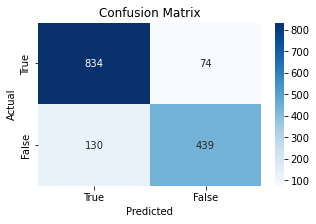

true_postives 834
true_negatives 439
false_postives 74
false_negatives 130
sensitivity 0.8651452282157677 to predict male, when they are really male
specificity 0.8557504873294347 to predict female, when they are really female
Postive Predictive value 0.9185022026431718 that a predicted male is really male
Negative Predictive value 0.7715289982425307 that a predicted female is really female


C= 4.5 Gamma= 2.0
SVC(C=4.5, gamma=2.0)
0.86 accuracy with a standard deviation of 0.02
0.8584997709573982 0.020919365523651968


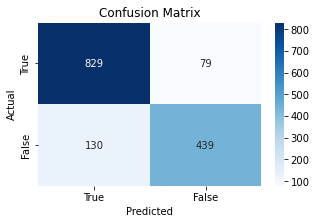

true_postives 829
true_negatives 439
false_postives 79
false_negatives 130
sensitivity 0.8644421272158499 to predict male, when they are really male
specificity 0.8474903474903475 to predict female, when they are really female
Postive Predictive value 0.9129955947136564 that a predicted male is really male
Negative Predictive value 0.7715289982425307 that a predicted female is really female




In [ ]:
c_list = [0.5, 1.5, 2.5, 3.5, 4.5]
g_list = [0.2, 0.5, 1.0, 1.5, 2.0]

for c in c_list:
    for g in g_list:
        print("C=",c, "Gamma=", g)
        
        model  = svm.SVC(C=c,gamma=g)
        model.fit(X_train,y_train)
        kfold = KFold(n_splits=5, random_state=0, shuffle=True)
        cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='accuracy')
        print(model)
        print("%0.2f accuracy with a standard deviation of %0.2f" % (cv_results.mean(), cv_results.std()))
        print(cv_results.mean(), cv_results.std())
        actual_classes, predicted_classes = cross_val_predict(model, kfold, X_train, y_train)
        matrix_and_results(actual_classes, predicted_classes, [True, False])



**The best model from this family is:**

SVC(C=0.5, gamma=2.0)
- see the cell below for the output of this model

**Discussion** 
- The SVC has an accuracy of 86%, 
- a postive predictive value (that a predicted male is indeed a male) of 90.3%
- a negative predictive value (that a predicted female is indeed a female) of 79%
- the difference between predictive values of males and females is 11.3%

This model **does not meet our success criteria** as the difference between predictive value between males and females is large. 


SVC(C=0.5, gamma=2.0)
0.86 accuracy with a standard deviation of 0.02
0.8598419606046726 0.020907599870074886


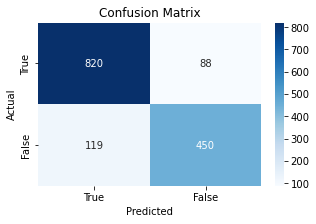

true_postives 820
true_negatives 450
false_postives 88
false_negatives 119
sensitivity 0.873269435569755 to predict male, when they are really male
specificity 0.8364312267657993 to predict female, when they are really female
Postive Predictive value 0.9030837004405287 that a predicted male is really male
Negative Predictive value 0.7908611599297012 that a predicted female is really female




In [ ]:
model  = svm.SVC(C=0.5,gamma=2.0)
model.fit(X_train,y_train)
kfold = KFold(n_splits=5, random_state=0, shuffle=True)
cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='accuracy')
print(model)
print("%0.2f accuracy with a standard deviation of %0.2f" % (cv_results.mean(), cv_results.std()))
print(cv_results.mean(), cv_results.std())
actual_classes, predicted_classes = cross_val_predict(model, kfold, X_train, y_train)
matrix_and_results(actual_classes, predicted_classes, [True, False])

### 8.12 LogisticRegression 

LogisticRegression(random_state=0)
0.85 accuracy with a standard deviation of 0.02
0.8469880897846999 0.02102628051712146


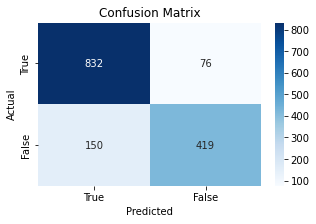

true_postives 832
true_negatives 419
false_postives 76
false_negatives 150
sensitivity 0.8472505091649695 to predict male, when they are really male
specificity 0.8464646464646465 to predict female, when they are really female
Postive Predictive value 0.9162995594713657 that a predicted male is really male
Negative Predictive value 0.7363796133567663 that a predicted female is really female




In [ ]:

from sklearn.linear_model import LogisticRegression


model  = LogisticRegression(random_state=0)
model.fit(X_train, y_train)
kfold = KFold(n_splits=5, random_state=0, shuffle=True)
cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='accuracy')
print(model)
print("%0.2f accuracy with a standard deviation of %0.2f" % (cv_results.mean(), cv_results.std()))
print(cv_results.mean(), cv_results.std())
actual_classes, predicted_classes = cross_val_predict(model, kfold, X_train, y_train)
matrix_and_results(actual_classes, predicted_classes, [True, False])



**Discussion** 
- The LogisticRegression has an accuracy of 85%, 
- a postive predictive value (that a predicted male is indeed a male) of 91.6%
- a negative predictive value (that a predicted female is indeed a female) of 73.6%
- the difference between predictive values of males and females is 18%

This model **does not meet our success criteria** as the difference between predictive value between males and females is large. 

### 8.13 Gaussian Naive Bayes

GaussianNB()
0.82 accuracy with a standard deviation of 0.02
0.8205817682088868 0.022167657698425082


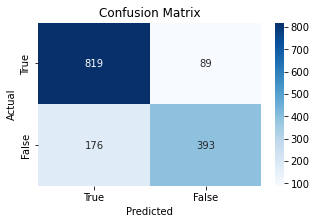

true_postives 819
true_negatives 393
false_postives 89
false_negatives 176
sensitivity 0.8231155778894472 to predict male, when they are really male
specificity 0.8153526970954357 to predict female, when they are really female
Postive Predictive value 0.9019823788546255 that a predicted male is really male
Negative Predictive value 0.6906854130052724 that a predicted female is really female




In [ ]:
from sklearn.naive_bayes import GaussianNB

model = GaussianNB()
model.fit(X_train, y_train)
kfold = KFold(n_splits=5, random_state=0, shuffle=True)
cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='accuracy')
print(model)
print("%0.2f accuracy with a standard deviation of %0.2f" % (cv_results.mean(), cv_results.std()))
print(cv_results.mean(), cv_results.std())
actual_classes, predicted_classes = cross_val_predict(model, kfold, X_train, y_train)
matrix_and_results(actual_classes, predicted_classes, [True, False])



**Discussion** 
- The GaussianNB has an accuracy of 82%, 
- a postive predictive value (that a predicted male is indeed a male) of 90.1%
- a negative predictive value (that a predicted female is indeed a female) of 69%
- the difference between predictive values of males and females is 21.1%

This model **does not meet our success criteria** as the difference between predictive value between males and females is large. 

### 8.14 QuadraticDiscriminantAnalysis

QuadraticDiscriminantAnalysis()
0.83 accuracy with a standard deviation of 0.02
0.8280164910673384 0.019201642244612484


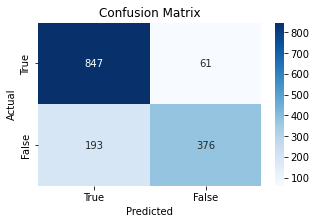

true_postives 847
true_negatives 376
false_postives 61
false_negatives 193
sensitivity 0.8144230769230769 to predict male, when they are really male
specificity 0.8604118993135011 to predict female, when they are really female
Postive Predictive value 0.9328193832599119 that a predicted male is really male
Negative Predictive value 0.6608084358523726 that a predicted female is really female




In [ ]:
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis


model = QuadraticDiscriminantAnalysis()
model.fit(X_train, y_train)
kfold = KFold(n_splits=5, random_state=0, shuffle=True)
cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='accuracy')
print(model)
print("%0.2f accuracy with a standard deviation of %0.2f" % (cv_results.mean(), cv_results.std()))
print(cv_results.mean(), cv_results.std())
actual_classes, predicted_classes = cross_val_predict(model, kfold, X_train, y_train)
matrix_and_results(actual_classes, predicted_classes, [True, False])


**Discussion** 
- The QuadraticDiscriminantAnalysis has an accuracy of 83%, 
- a postive predictive value (that a predicted male is indeed a male) of 93.2%
- a negative predictive value (that a predicted female is indeed a female) of 66%
- the difference between predictive values of males and females is 27.2%

This model **does not meet our success criteria** as the difference between predictive value between males and females is large. 

### 8.15 Retuning Random forrest classifier with class_weight='balanced'
So far the Random forrest classifier is the only model which has met our success critieria:
of reducing the predictive value of males and females whilst maintaining accuracy. 

looking into this model further it is possible to pass in the varaible class_weight="balanced" which allows the algorthim to try and balance the weights of classes it is passed to classify, 

we will now re-run the hyperparameter training of the RandomForrestClassifier with different n_estimators and the class_weights="balanced" to see if we can improve on our model

RandomForestClassifier(class_weight='balanced', n_estimators=1, random_state=0)
0.77 accuracy with a standard deviation of 0.03


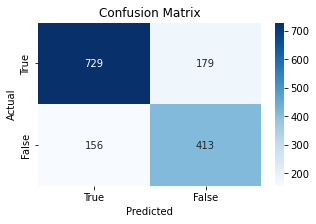

true_postives 729
true_negatives 413
false_postives 179
false_negatives 156
sensitivity 0.823728813559322 to predict male, when they are really male
specificity 0.6976351351351351 to predict female, when they are really female
Postive Predictive value 0.802863436123348 that a predicted male is really male
Negative Predictive value 0.7258347978910369 that a predicted female is really female


RandomForestClassifier(class_weight='balanced', n_estimators=3, random_state=0)
0.82 accuracy with a standard deviation of 0.02


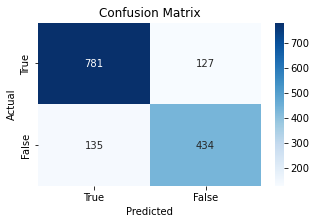

true_postives 781
true_negatives 434
false_postives 127
false_negatives 135
sensitivity 0.8526200873362445 to predict male, when they are really male
specificity 0.7736185383244206 to predict female, when they are really female
Postive Predictive value 0.8601321585903083 that a predicted male is really male
Negative Predictive value 0.7627416520210897 that a predicted female is really female


RandomForestClassifier(class_weight='balanced', n_estimators=5, random_state=0)
0.84 accuracy with a standard deviation of 0.03


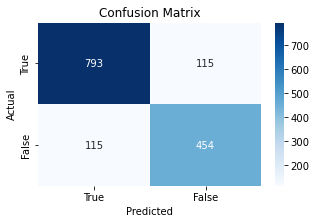

true_postives 793
true_negatives 454
false_postives 115
false_negatives 115
sensitivity 0.8733480176211453 to predict male, when they are really male
specificity 0.7978910369068541 to predict female, when they are really female
Postive Predictive value 0.8733480176211453 that a predicted male is really male
Negative Predictive value 0.7978910369068541 that a predicted female is really female


RandomForestClassifier(class_weight='balanced', n_estimators=10, random_state=0)
0.84 accuracy with a standard deviation of 0.02


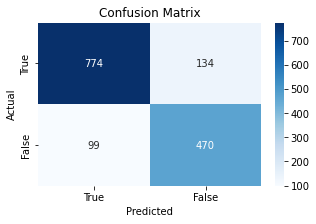

true_postives 774
true_negatives 470
false_postives 134
false_negatives 99
sensitivity 0.8865979381443299 to predict male, when they are really male
specificity 0.7781456953642384 to predict female, when they are really female
Postive Predictive value 0.8524229074889867 that a predicted male is really male
Negative Predictive value 0.8260105448154658 that a predicted female is really female


RandomForestClassifier(class_weight='balanced', n_estimators=15, random_state=0)
0.85 accuracy with a standard deviation of 0.02


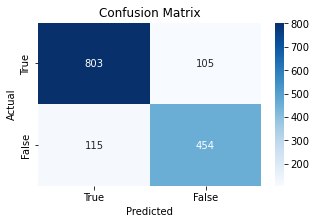

true_postives 803
true_negatives 454
false_postives 105
false_negatives 115
sensitivity 0.8747276688453159 to predict male, when they are really male
specificity 0.8121645796064401 to predict female, when they are really female
Postive Predictive value 0.8843612334801763 that a predicted male is really male
Negative Predictive value 0.7978910369068541 that a predicted female is really female


RandomForestClassifier(class_weight='balanced', n_estimators=20, random_state=0)
0.85 accuracy with a standard deviation of 0.02


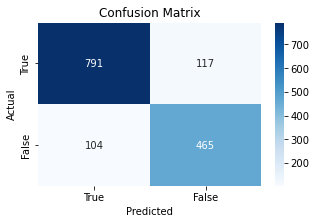

true_postives 791
true_negatives 465
false_postives 117
false_negatives 104
sensitivity 0.8837988826815643 to predict male, when they are really male
specificity 0.7989690721649485 to predict female, when they are really female
Postive Predictive value 0.8711453744493393 that a predicted male is really male
Negative Predictive value 0.8172231985940246 that a predicted female is really female


RandomForestClassifier(class_weight='balanced', n_estimators=25, random_state=0)
0.85 accuracy with a standard deviation of 0.02


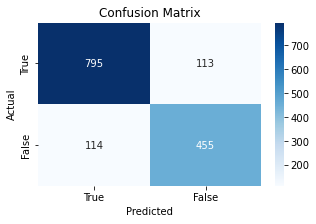

true_postives 795
true_negatives 455
false_postives 113
false_negatives 114
sensitivity 0.8745874587458746 to predict male, when they are really male
specificity 0.801056338028169 to predict female, when they are really female
Postive Predictive value 0.8755506607929515 that a predicted male is really male
Negative Predictive value 0.7996485061511424 that a predicted female is really female


RandomForestClassifier(class_weight='balanced', n_estimators=50, random_state=0)
0.85 accuracy with a standard deviation of 0.02


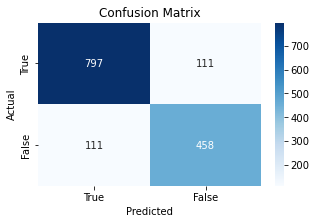

true_postives 797
true_negatives 458
false_postives 111
false_negatives 111
sensitivity 0.8777533039647577 to predict male, when they are really male
specificity 0.804920913884007 to predict female, when they are really female
Postive Predictive value 0.8777533039647577 that a predicted male is really male
Negative Predictive value 0.804920913884007 that a predicted female is really female


RandomForestClassifier(class_weight='balanced', random_state=0)
0.85 accuracy with a standard deviation of 0.02


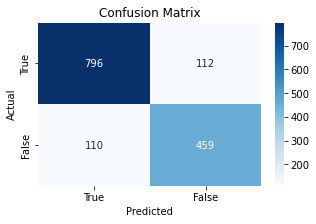

true_postives 796
true_negatives 459
false_postives 112
false_negatives 110
sensitivity 0.8785871964679912 to predict male, when they are really male
specificity 0.8038528896672504 to predict female, when they are really female
Postive Predictive value 0.8766519823788547 that a predicted male is really male
Negative Predictive value 0.8066783831282952 that a predicted female is really female




In [ ]:

from sklearn.model_selection import KFold, cross_val_score
from sklearn.ensemble import RandomForestClassifier
n_estimators = [1, 3, 5, 10, 15, 20, 25, 50, 100]
for estimator in n_estimators:
    
    model = RandomForestClassifier(n_estimators=estimator, class_weight='balanced' , random_state=0)
    kfold = KFold(n_splits=5, random_state=0, shuffle=True)
    cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='accuracy')
    print(model)
    print("%0.2f accuracy with a standard deviation of %0.2f" % (cv_results.mean(), cv_results.std()))
    actual_classes, predicted_classes = cross_val_predict(model, kfold, X_train, y_train)
    matrix_and_results(actual_classes, predicted_classes, [True, False])

**Previous random forrest result**
- RandomForestClassifier(n_estimators=10, random_state=0)
- The RandomForestClassifier has an accuracy of 85%, 
- a postive predictive value (that a predicted male is indeed a male) of 86.3%
- a negative predictive value (that a predicted female is indeed a female) of 82.6%
- the difference between predictive values of males and females is 3.7%


**The best two models from this family (class_weights='balanced') are:**

RandomForestClassifier(class_weight='balanced', n_estimators=10, random_state=0)
- The RandomForestClassifier has an accuracy of 84%, 
- a postive predictive value (that a predicted male is indeed a male) of 85.2%
- a negative predictive value (that a predicted female is indeed a female) of 82.6%
- the difference between predictive values of males and females is 2.6%


RandomForestClassifier(class_weight='balanced', n_estimators=20, random_state=0)
- The RandomForestClassifier has an accuracy of 85%, 
- a postive predictive value (that a predicted male is indeed a male) of 87.1%
- a negative predictive value (that a predicted female is indeed a female) of 81.7%
- the difference between predictive values of males and females is 5.4%

**Discussion:**
- It appears that the two best models are both Random forest classifiers with 10 estimators.
- the only difference is the the use of the class_weights='balanced'
- we will now take these two models into the final evaluation with the test dataset



### 8.16 creation of pipelines for the best two performing models
### Random Forest Classifier (n_estimators-10, class_weight='balanced')

In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier

scaler = StandardScaler()

model  = RandomForestClassifier(n_estimators=10, class_weight='balanced', random_state=0)

pipe_random_forrest_balanced = Pipeline([('StandardScaler',scaler), ('RandomForest', model)])

pipe_random_forrest_balanced.fit(X_train_unscaled, y_train)

Pipeline(steps=[('StandardScaler', StandardScaler()),
                ('RandomForest',
                 RandomForestClassifier(class_weight='balanced',
                                        n_estimators=10, random_state=0))])

### Random Forest Classifier (n_estimators-10, class_weight=None)

In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier

scaler = StandardScaler()

model  = RandomForestClassifier(n_estimators=10, random_state=0)

pipe_random_forrest_none = Pipeline([('StandardScaler',scaler), ('RandomForest', model)])

pipe_random_forrest_none.fit(X_train_unscaled, y_train)

Pipeline(steps=[('StandardScaler', StandardScaler()),
                ('RandomForest',
                 RandomForestClassifier(n_estimators=10, random_state=0))])

### 8.17 Evaluation of best two performing models with the test dataset
### Random Forest Classifier (n_estimators-10, class_weight='balanced')

0.8609794628751974
Training Accuracy 0.983073798239675
Validation  Accuracy 0.8609794628751974


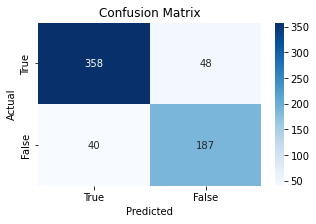

true_postives 358
true_negatives 187
false_postives 48
false_negatives 40
sensitivity 0.8994974874371859 to predict male, when they are really male
specificity 0.7957446808510639 to predict female, when they are really female
Postive Predictive value 0.8817733990147784 that a predicted male is really male
Negative Predictive value 0.8237885462555066 that a predicted female is really female




In [ ]:

pipe_random_score = pipe_random_forrest_balanced.score(X_val_unscaled, y_val)

print(pipe_random_score)

yt_p = pipe_random_forrest_balanced.predict(X_train_unscaled)
yv_p = pipe_random_forrest_balanced.predict(X_val_unscaled)

print('Training Accuracy', np.mean(yt_p==y_train))
print('Validation  Accuracy', np.mean(yv_p==y_val))


actual_labels = y_val
predicted_labels = pipe_random_forrest_balanced.predict(X_val_unscaled)

matrix_and_results(actual_labels, predicted_labels, [True, False])

### Random Forest Classifier (n_estimators-10, class_weight=None)

0.8609794628751974
Training Accuracy 0.980365605958023
Validation  Accuracy 0.8609794628751974


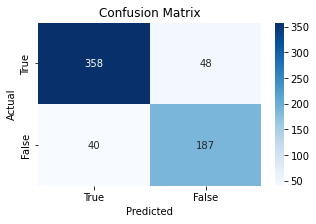

true_postives 358
true_negatives 187
false_postives 48
false_negatives 40
sensitivity 0.8994974874371859 to predict male, when they are really male
specificity 0.7957446808510639 to predict female, when they are really female
Postive Predictive value 0.8817733990147784 that a predicted male is really male
Negative Predictive value 0.8237885462555066 that a predicted female is really female




In [ ]:
pipe_random_score = pipe_random_forrest.score(X_val_unscaled, y_val)

print(pipe_random_score)

yt_p = pipe_random_forrest_none.predict(X_train_unscaled)
yv_p = pipe_random_forrest_none.predict(X_val_unscaled)

print('Training Accuracy', np.mean(yt_p==y_train))
print('Validation  Accuracy', np.mean(yv_p==y_val))


actual_labels = y_val
predicted_labels = pipe_random_forrest_none.predict(X_val_unscaled)

matrix_and_results(actual_labels, predicted_labels, [True, False])

### 8.18 Selection of the best performing model

There is no difference between our two final models in terms of the success criteria. 
both models achieved:
- An accuracy of 86%, 
- a postive predictive value (that a predicted male is indeed a male) of 88.1%
- a negative predictive value (that a predicted female is indeed a female) of 82.3%
- the difference between predictive values of males and females is 5.8%

The final selection of the model could be decided by flipping a coin, but a small difference does exist in the training accuracy of the models with the class_weights='balanced' having a 0.3% improve prediction rate. 
Both models achieve an 98% training accuracy, which may indicate over fitting, but its not 1.0.

The final model to be trained for production will be:
##### Random Forest Classifier (n_estimators-10, class_weight='balanced')

### 8.19 Final training of the final model with the entire dataset ready for production. 

- In this final step we will take our un normalised full dataset, and select only the features used to train the model. 
- we then train the model with all the data, and hand it over to you, the reader to validate with your own test data. 

In [ ]:
feature_set = ['pitch_mean', 'pitch_std', 'pow_spec_std', 'male']
finalset = full_df[feature_set].copy()
display(finalset)

,pitch_mean,pitch_std,pow_spec_std,male
0,325.236666,28.786019,0.312440,False
1,231.461977,40.139432,0.314011,False
2,124.816188,13.131737,0.295595,True
3,224.327978,39.453351,0.299755,False
4,240.915619,15.027745,0.333484,False
...,...,...,...,...
2494,87.974646,2.132672,0.235895,False
2495,169.608125,18.657903,0.325355,True
2497,130.582934,6.261421,0.292370,True
2498,128.840731,3.493958,0.268440,True


In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier

scaler = StandardScaler()

model  = RandomForestClassifier(n_estimators=10, class_weight='balanced', random_state=0)

production_pipeline = Pipeline([('StandardScaler',scaler), ('RandomForest', model)])

production_pipeline.fit(finalset.iloc[:,:-1], finalset.iloc[:,-1])

Pipeline(steps=[('StandardScaler', StandardScaler()),
                ('RandomForest',
                 RandomForestClassifier(class_weight='balanced',
                                        n_estimators=10, random_state=0))])

# 9 Conclusions



The final output of this project has an estimate accuracy of 86% with our testing data. 
The model was chosen on the basis of the success criteria which was to reduce bias in the models so that both classes (male and females voiced) were given as close to equal weighing as could be achieved given the imbalance in the original dataset. 

When the model predicts a male voice, there is an 88.1% chance that it comes from a male. 
when the model predicts a female voice, there is an 82.3% change that it comes from a female. 
This represents only a 5.8% difference in prediction accuracy. 

I am happy with this result, and the balance I have achieved between the prediction accuracy of male and female voices. 

During the course of model selection it was clear that some models were able to predict male voices with a much higher degree of accuracy (93% in the case of Quadratic Discriminant Analysis) however this came at a cost of much lower prediction accuracy for female voices. 

It is understandable that models are chosen when the accuracy of one class is higher, but in the case of two classes which are of equal value, the ML enginner's focus on the right metrics for the problem seems to be a key learning from me for this work. 

In my own interest in healthcare, I see another issue, which this project has made me aware of. Diseases are always a minority in the dataset, and minority groups (be they racial or behavioural) are likely to be classified differently without a clear focus on reducing this bias in the pipeline design process. 

This will have to be balanced by the reasonable requirement to reach the highest accuracy possible for the general population, and one might need to consider that seperate models or pipelines might need to be built for the majority group and the minorty groups if they are all to benefit from predictions that come from ML models. 
